<table>
<tr>                                                                                   
     <th>
         <div style='padding:15px;color:#030aa7;font-size:240%;text-align: center;font-style: italic;font-weight: bold;font-family: Georgia, serif'><a href="https://www.kaggle.com/datasets/parulpandey/palmer-archipelago-antarctica-penguin-data/data">Pinguins - Archipel Palmer (Antarctica)</a></div>
     </th>
     <th><img src="https://raw.githubusercontent.com/rbizoi/MachineLearning/refs/heads/master/images/palmer_pinguins.png" width="96"></th>
 </tr>
</table>

<div style='text-align: center'>
<img src="https://raw.githubusercontent.com/rbizoi/MachineLearning/refs/heads/master/images/penguins_species.png" width="512">
</div>


<div style='padding:15px;color:#030aa7;font-size:100%;text-align: left;font-family: Georgia, serif'><a href="https://github.com/allisonhorst/palmerpenguins/blob/main/README.md">Veuillez vous référer à la page Github officielle pour plus de détails.</a></div>

# <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Introduction</div></b>
## <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Import libriries </div></b>

In [1]:
import pandas as pd, numpy as np, seaborn as sns, warnings, os, time
from datetime import datetime as dt
from matplotlib import pyplot as plt

import matplotlib.font_manager as fm
import plotly.express as px
import plotly.graph_objs as go

font1 = fm.FontProperties(size=20)
font2 = fm.FontProperties(size=24)

warnings.filterwarnings(action="ignore")

if int(str(sns.__version__).split('.')[1]) > 8 : 
    plt.style.use('seaborn-v0_8-darkgrid')
else:
    plt.style.use('seaborn-darkgrid')
sns.set(font_scale=2)

In [2]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler,MinMaxScaler
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.cluster.hierarchy import fcluster
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

In [3]:
from matplotlib.colors import ListedColormap
from itertools import cycle
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis

from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression, SGDClassifier
from sklearn.svm import NuSVC, SVC, OneClassSVM
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import ConstantKernel, RBF, RationalQuadratic, ExpSineSquared, DotProduct, Matern, WhiteKernel

from sklearn.tree import DecisionTreeClassifier, export_graphviz, plot_tree
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB, ComplementNB
from lightgbm import LGBMClassifier
from xgboost  import XGBClassifier
from sklearn.metrics import roc_curve, auc

from sklearn.metrics import make_scorer, confusion_matrix, roc_curve, auc, accuracy_score, log_loss, hamming_loss, \
                            precision_score, recall_score, f1_score, fbeta_score, jaccard_score, \
                            precision_recall_curve, average_precision_score, balanced_accuracy_score, \
                            classification_report
from sklearn.metrics import roc_auc_score, zero_one_loss
from sklearn.metrics import multilabel_confusion_matrix
from sklearn.model_selection import KFold, StratifiedKFold, RepeatedKFold, \
                                    RepeatedStratifiedKFold, LeavePOut, LeaveOneGroupOut, \
                                    LeavePGroupsOut, ShuffleSplit, StratifiedShuffleSplit, TimeSeriesSplit, GridSearchCV

from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier,OneVsOneClassifier

from sklearn.neighbors  import LocalOutlierFactor
from sklearn.covariance import EllipticEnvelope
from sklearn.ensemble   import IsolationForest
from sklearn.svm        import OneClassSVM

## <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Outils du document</div></b>

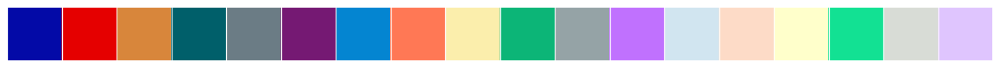

In [4]:
palette = [ "#030aa7", "#e50000", "#d8863b", "#005f6a", "#6b7c85", "#751973", 
            "#0485d1", "#ff7855", "#fbeeac", "#0cb577", "#95a3a6", "#c071fe", 
            "#d1e5f0", "#fddbc7", "#ffffcb", "#12e193", "#d8dcd6", "#dfc5fe", 
          ]
sns.palplot(sns.color_palette(palette))

In [5]:
repertoireRacine  = '.'
nomProjet         = 'Pinguins-Palmer Archipelago'

repertoireProjet  = os.path.join(repertoireRacine, nomProjet)
repertoireDonnees = os.path.join(repertoireProjet, 'repertoire.donnees')
repertoireImages  = os.path.join(repertoireProjet, 'repertoire.images')


def controleExistenceRepertoire( repertoire, create_if_needed=True):
    """Voir si le répertoire existe. S'il n'existe pas il est créé."""
    path_exists = os.path.exists(repertoire)
    if path_exists:
        if not os.path.isdir(repertoire):
            raise Exception("Trouvé le nom  "+repertoire +" mais c'est un fichier, pas un répertoire")
            # return False
        return True
    if create_if_needed:
        os.makedirs(repertoire)

def sauvegarderImage( fichier):
    """Enregistrez la figure. Appelez la méthode juste avant plt.show ()."""
    controleExistenceRepertoire(repertoireImages)
    plt.savefig(os.path.join(repertoireImages,
                             fichier+f"--{dt.now().strftime('%Y_%m_%d_%H.%M.%S')}.png"), 
                             dpi=600, 
                             bbox_inches='tight')

def sauvegarderImageSNS( sns_plot, fichier):
    """Enregistrez la figure. Appelez la méthode juste avant plt.show ()."""
    controleExistenceRepertoire(repertoireImages)
    fig = sns_plot.get_figure()
    fig.savefig(os.path.join(repertoireImages,fichier+'.png'))
    
controleExistenceRepertoire(repertoireProjet);
controleExistenceRepertoire(repertoireDonnees);
controleExistenceRepertoire(repertoireImages);

In [6]:
def formatPct(pct, allvals):
    total = int(round(pct/100. * np.sum(allvals)))
    return "{:.2f}%\n({:d})".format(pct, total)    

In [7]:
def affichageDistribution(colonne,couleur,ax):
    graph = sns.distplot(colonne, color=couleur, ax=ax)
    graph.set(ylabel=None)
    moyenne, mediane = float(colonne.mean()), \
                   float(colonne.median())
    
    ax.axvline(moyenne, color='g', linestyle='-', label="mean   = {0:0.1f}".format(moyenne), lw=2)
    ax.axvline(mediane, color='b', linestyle='--', label="median = {0:0.1f}".format(mediane), lw=2)
    graph.legend(loc="upper right")

In [8]:
def afficheDendrogram(*args, **kwargs):
    max_d = kwargs.pop('max_d', None)
    if max_d and 'color_threshold' not in kwargs:
        kwargs['color_threshold'] = max_d
    annotate_above = kwargs.pop('annotate_above', 0)

    ddata = dendrogram(*args, **kwargs)

    if not kwargs.get('no_plot', False):
        plt.title('Classification Hiérarchique Ascendante')
        plt.xlabel('Villes ou (taille du cluster)')
        plt.ylabel('Distance')
        for i, d, c in zip(ddata['icoord'], ddata['dcoord'], ddata['color_list']):
            x = 0.5 * sum(i[1:3])
            y = d[1]
            if y > annotate_above:
                plt.plot(x, y, 'o', c=c)
                plt.annotate("%.3g" % y, (x, y), xytext=(0, -5),
                             textcoords='offset points',
                             va='top', ha='center')
        if max_d:
            plt.axhline(y=max_d, c='k')
    return ddata

# <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Lecture des données</div></b>

<table>
    <CAPTION style='padding:15px;color:#030aa7;font-size:150%;text-align: left;font-weight: bold;font-family: Georgia, serif'>penguins_size.csv</CAPTION>    
<tr>                                                                                   
     <th>
            <table>
            <tr>                                                                                   
                 <th  style="text-align:left;background-color:#053061;color:white;">Colonne initiale </th>
                 <th  style="text-align:left;background-color:#053061;color:white;">Description</th>
             </tr>
            <tr>
                <th  style="text-align:left">species</th>
                <th  style="text-align:left">espèces de manchots (Chinstrap, Adélie ou Gentoo)</th>
            </tr>
            <tr>
                <th  style="text-align:left">culmen_length_mm</th>
                <th  style="text-align:left">longueur du culmen (culmen est la crête supérieure du bec d'un oiseau)(mm)</th>
            </tr>
            <tr>
                <th  style="text-align:left">culmen_depth_mm</th>
                <th  style="text-align:left">profondeur du culmen (culmen est la crête supérieure du bec d'un oiseau)(mm)</th>
            </tr>
            <tr>
                <th  style="text-align:left">flipper_length_mm</th>
                <th  style="text-align:left">longueur des nageoires (mm)</th>
            </tr>
            <tr>
                <th  style="text-align:left">body_mass_g</th>
                <th  style="text-align:left">masse corporelle (g)</th>
            </tr>
            <tr>
                <th  style="text-align:left">island</th>
                <th  style="text-align:left">nom de l'île (Dream, Torgersen ou Biscoe) dans l'archipel Palmer (Antarctique)</th>
            </tr>
            <tr>
                <th  style="text-align:left">sex</th>
                <th  style="text-align:left">sexe du manchot</th>
            </tr>
            </table>
     </th>
     <th><img src="https://raw.githubusercontent.com/rbizoi/MachineLearning/refs/heads/master/images/culmen.png" width="512"></th>
 </tr>
</table>

In [9]:
donnees = pd.read_csv('../donnees/Palmer Archipelago-Antarctica-Penguin/penguins_size.csv')

In [10]:
quantitatives = ['culmen_length_mm', 'culmen_depth_mm', 'flipper_length_mm', 'body_mass_g']
qualitatives = ['island', 'sex']
cible = 'species'

## <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Effacement des valeurs non renseignés</div></b>

In [11]:
donnees[donnees.body_mass_g.isna()]

,species,island,culmen_length_mm,culmen_depth_mm,flipper_length_mm,body_mass_g,sex
3,Adelie,Torgersen,NaN,NaN,NaN,NaN,NaN
339,Gentoo,Biscoe,NaN,NaN,NaN,NaN,NaN


<b><div style='padding:15px;color:#030aa7;font-size:100%;text-align: left'>Je pense que je peux supprimer les lignes avec les entrées nulles sans causer de problèmes majeurs.</div></b>

In [12]:
donnees = donnees[~donnees.body_mass_g.isna()]
donnees.info()

<class 'pandas.core.frame.DataFrame'>
Index: 342 entries, 0 to 343
Data columns (total 7 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   species            342 non-null    object 
 1   island             342 non-null    object 
 2   culmen_length_mm   342 non-null    float64
 3   culmen_depth_mm    342 non-null    float64
 4   flipper_length_mm  342 non-null    float64
 5   body_mass_g        342 non-null    float64
 6   sex                334 non-null    object 
dtypes: float64(4), object(3)
memory usage: 21.4+ KB


In [13]:
donnees.duplicated().sum()

0

## <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Variables qualitatives</div></b>

In [14]:
qualitatives = ['island', 'sex']

### <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Espèces de manchots</div></b>

In [15]:
donnees.species.sort_values().unique()

array(['Adelie', 'Chinstrap', 'Gentoo'], dtype=object)

In [16]:
dict_species = {nom:i for i, nom in enumerate(donnees.species.sort_values().unique())}
dictR_species = {i:nom for i, nom in enumerate(donnees.species.sort_values().unique())}
dict_species,dictR_species

({'Adelie': 0, 'Chinstrap': 1, 'Gentoo': 2},
 {0: 'Adelie', 1: 'Chinstrap', 2: 'Gentoo'})

In [17]:
donnees['espece'] = donnees.species
donnees.species = donnees.species.apply(lambda x: dict_species[x])

### <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Sexe du manchot</div></b>

In [18]:
donnees.sex.sort_values().unique()

array(['.', 'FEMALE', 'MALE', nan], dtype=object)

In [19]:
donnees[(donnees.sex == '.' )|(donnees.sex.isna() ) ]

,species,island,culmen_length_mm,culmen_depth_mm,flipper_length_mm,body_mass_g,sex,espece
8,0,Torgersen,34.1,18.1,193.0,3475.0,NaN,Adelie
9,0,Torgersen,42.0,20.2,190.0,4250.0,NaN,Adelie
10,0,Torgersen,37.8,17.1,186.0,3300.0,NaN,Adelie
11,0,Torgersen,37.8,17.3,180.0,3700.0,NaN,Adelie
47,0,Dream,37.5,18.9,179.0,2975.0,NaN,Adelie
246,2,Biscoe,44.5,14.3,216.0,4100.0,NaN,Gentoo
286,2,Biscoe,46.2,14.4,214.0,4650.0,NaN,Gentoo
324,2,Biscoe,47.3,13.8,216.0,4725.0,NaN,Gentoo
336,2,Biscoe,44.5,15.7,217.0,4875.0,.,Gentoo


In [20]:
donnees.sex = donnees.sex.apply(lambda x : None if x == '.' else x).fillna('none').apply(lambda x: str(x).lower())
donnees.sex.sort_values().unique()

array(['female', 'male', 'none'], dtype=object)

In [21]:
dict_sex = {nom:i for i, nom in enumerate(donnees.sex.sort_values().unique())}
dictR_sex = {i:nom for i, nom in enumerate(donnees.sex.sort_values().unique())}
dict_sex,dictR_sex

({'female': 0, 'male': 1, 'none': 2}, {0: 'female', 1: 'male', 2: 'none'})

In [22]:
donnees['sexe'] = donnees.sex
donnees.sex = donnees.sex.apply(lambda x: dict_sex[x])

### <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Nom de l'île</div></b>

<img src="https://raw.githubusercontent.com/rbizoi/MachineLearning/refs/heads/master/images/pinguins_archipel_palmer.png" width="1024">

In [23]:
donnees.island.sort_values().unique()

array(['Biscoe', 'Dream', 'Torgersen'], dtype=object)

In [24]:
dict_island = {nom:i for i, nom in enumerate(donnees.island.sort_values().unique())}
dictR_island = {i:nom for i, nom in enumerate(donnees.island.sort_values().unique())}
dict_island,dictR_island

({'Biscoe': 0, 'Dream': 1, 'Torgersen': 2},
 {0: 'Biscoe', 1: 'Dream', 2: 'Torgersen'})

In [25]:
donnees['nom_ile'] = donnees.island
donnees.island = donnees.island.apply(lambda x: dict_island[x])

In [26]:
qualitativesT = ['espece', 'sexe', 'nom_ile']

# <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Statistiques descriptives et analyse de données</div></b>

## <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Couleurs variables qualitatives</div></b>

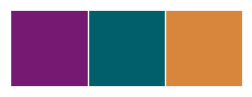

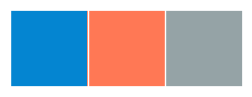

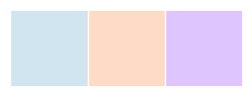

In [27]:
couleursEspece = {nom:couleur for nom,couleur in zip(donnees.espece.sort_values().unique(),["#751973","#005f6a","#d8863b"])}
couleursSexe = {nom:couleur for nom,couleur in zip(donnees.sexe.sort_values().unique(),["#0485d1","#ff7855","#95a3a6"])}
couleursNomIle = {nom:couleur for nom,couleur in zip(donnees.nom_ile.sort_values().unique(),["#d1e5f0", "#fddbc7","#dfc5fe"])}
sns.palplot(sns.color_palette(couleursEspece.values()))
sns.palplot(sns.color_palette(couleursSexe.values()))
sns.palplot(sns.color_palette(couleursNomIle.values()))

## <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Statistiques  descriptives</div></b>

In [28]:
donnees.sample(5)

,species,island,culmen_length_mm,culmen_depth_mm,flipper_length_mm,body_mass_g,sex,espece,sexe,nom_ile
276,2,0,43.8,13.9,208.0,4300.0,0,Gentoo,female,Biscoe
290,2,0,47.7,15.0,216.0,4750.0,0,Gentoo,female,Biscoe
223,2,0,50.0,15.2,218.0,5700.0,1,Gentoo,male,Biscoe
68,0,2,35.9,16.6,190.0,3050.0,0,Adelie,female,Torgersen
5,0,2,39.3,20.6,190.0,3650.0,1,Adelie,male,Torgersen


In [29]:
donnees.drop(columns=qualitativesT).describe().style.format("{:0.2f}") #.background_gradient(cmap=plt.get_cmap('Blues'),axis=0)

,species,island,culmen_length_mm,culmen_depth_mm,flipper_length_mm,body_mass_g,sex
count,342.00,342.00,342.00,342.00,342.00,342.00,342.00
mean,0.92,0.66,43.92,17.15,200.92,4201.75,0.54
std,0.89,0.72,5.46,1.97,14.06,801.95,0.55
min,0.00,0.00,32.10,13.10,172.00,2700.00,0.00
25%,0.00,0.00,39.23,15.60,190.00,3550.00,0.00
50%,1.00,1.00,44.45,17.30,197.00,4050.00,1.00
75%,2.00,1.00,48.50,18.70,213.00,4750.00,1.00
max,2.00,2.00,59.60,21.50,231.00,6300.00,2.00


In [30]:
donnees.columns

Index(['species', 'island', 'culmen_length_mm', 'culmen_depth_mm',
       'flipper_length_mm', 'body_mass_g', 'sex', 'espece', 'sexe', 'nom_ile'],
      dtype='object')

## <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Structure de l’échantillon des données </div></b>

In [31]:
donnees.sample(5)

,species,island,culmen_length_mm,culmen_depth_mm,flipper_length_mm,body_mass_g,sex,espece,sexe,nom_ile
90,0,1,35.7,18.0,202.0,3550.0,0,Adelie,female,Dream
51,0,0,40.1,18.9,188.0,4300.0,1,Adelie,male,Biscoe
59,0,0,37.6,19.1,194.0,3750.0,1,Adelie,male,Biscoe
58,0,0,36.5,16.6,181.0,2850.0,0,Adelie,female,Biscoe
67,0,0,41.1,19.1,188.0,4100.0,1,Adelie,male,Biscoe


In [32]:
affichage = donnees.groupby(['espece','sexe']).sex.count().reset_index().rename(columns={'sex':'nombre'})
affichage['%'] = affichage.nombre * 100 / affichage.nombre.sum()
affichage.pivot_table(
    index='espece',
    columns='sexe',
    values='nombre',
    # fill_value=0
    ).style.format("{:0.2f}").background_gradient(cmap=plt.get_cmap('Blues'),axis=0)

sexe,female,male,none
espece,,,
Adelie,73.00,73.00,5.00
Chinstrap,34.00,34.00,nan
Gentoo,58.00,61.00,4.00


In [33]:
affichage = donnees.groupby(['espece','nom_ile']).sex.count().reset_index().rename(columns={'sex':'nombre'})
affichage['%'] = affichage.nombre * 100 / affichage.nombre.sum()
affichage.pivot_table(
    index='espece',
    columns='nom_ile',
    values='nombre',
    # fill_value=0
    ).style.format("{:0.2f}").background_gradient(cmap=plt.get_cmap('Blues'),axis=0)

nom_ile,Biscoe,Dream,Torgersen
espece,,,
Adelie,44.00,56.00,51.00
Chinstrap,nan,68.00,nan
Gentoo,123.00,nan,nan


In [34]:
affichage = donnees.groupby(['nom_ile','espece','sexe']).sex.count().reset_index().rename(columns={'sex':'nombre'})
affichage['%'] = affichage.nombre * 100 / affichage.nombre.sum()
affichage.pivot_table(
    index=['espece','sexe'],
    columns='nom_ile',
    values='nombre',
    # fill_value=0
    ).style.format("{:0.2f}").background_gradient(cmap=plt.get_cmap('Blues'),axis=0)

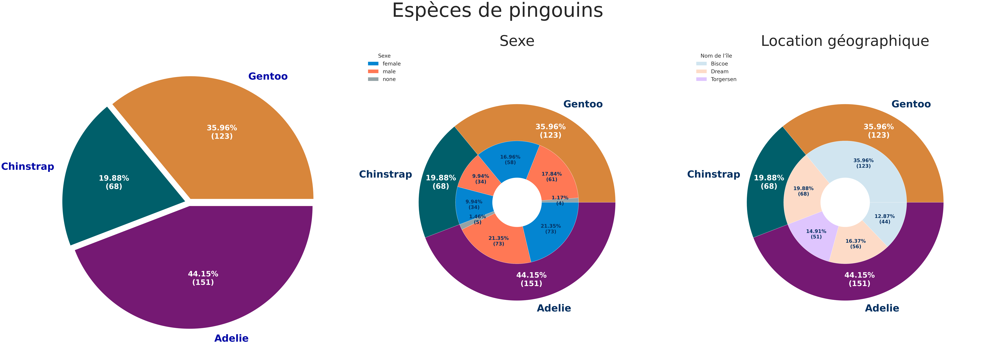

In [35]:
radius,size=0.8,0.3
fig,(ax0,ax1,ax2) = plt.subplots(ncols=3,figsize=(92,36), subplot_kw=dict(aspect="equal"))

affichage = donnees.groupby(['espece']).sex.count().reset_index().rename(columns={'sex':'nombre'})
affichage['%'] = affichage.nombre * 100 / affichage.nombre.sum()
affichage

wedges, texts, autotexts =  ax0.pie(
         affichage['nombre'],
         autopct=lambda pct: formatPct(pct, affichage.nombre.values),   # autopct='%1.2f%%', 
         labels=affichage['espece'].values,
         # shadow=True, 
         counterclock=False,
         startangle=0 ,
         colors = couleursEspece.values(),
         # pctdistance=0.4, 
         labeldistance=1.1, 
         textprops=dict(color="#030aa7"),
         explode=(0.03,0.03,0.03)
      );
plt.setp(autotexts, size=48, weight="bold",color="w")
plt.setp(texts, size=64, weight="bold")

affichage = donnees.groupby(['espece']).sex.count().reset_index().rename(columns={'sex':'nombre'})
affichage['%'] = affichage.nombre * 100 / affichage.nombre.sum()
affichage.sort_values(['espece'],inplace=True)

wedges, texts, autotexts =  ax1.pie( 
                                    affichage['nombre'],
                                    autopct=lambda pct: formatPct(pct, affichage.nombre.values),   # autopct='%1.2f%%', 
                                    labels=affichage['espece'].values,
                                    counterclock=False,
                                    wedgeprops=dict(width=0.3),
                                    pctdistance=0.8,
                                    radius=radius, 
                                    colors=couleursEspece.values(),
                                    # wedgeprops=dict(width=size, edgecolor='w'),
                                    textprops=dict(color='#053061',fontsize='x-large'),
                                    startangle=0 ,)
plt.setp(autotexts, size=48, weight="bold",color="w")
plt.setp(texts, size=64, weight="bold")

affichage = donnees.groupby(['espece','sexe']).sex.count().reset_index().rename(columns={'sex':'nombre'})
affichage['%'] = affichage.nombre * 100 / affichage.nombre.sum()
affichage.sort_values(['espece','sexe'],inplace=True)

wedges, texts, autotexts =  ax1.pie( 
                                    affichage['nombre'],
                                    autopct=lambda pct: formatPct(pct, affichage.nombre.values),   # autopct='%1.2f%%', 
                                    # labels=affichage['sexe'].values,
                                    counterclock=False,
                                    pctdistance=0.7,
                                    radius=radius-size, 
                                    colors=affichage['sexe'].apply(lambda x : couleursSexe[x]),
                                    wedgeprops=dict(width=size, edgecolor='w'),
                                    textprops=dict(color="#053061"),
                                    startangle=0 ,)
plt.setp(autotexts, size=32, weight="bold")
plt.setp(texts, size=32, weight="bold",color="w")
ax1.legend(wedges, affichage['sexe'].unique(),
          title="Sexe",
          loc="upper left",
          fontsize ='x-large', 
          title_fontsize='x-large', 
          bbox_to_anchor=(0, 1))
ax1.set_title("Sexe", size=96);

affichage = donnees.groupby(['espece']).nom_ile.count().reset_index().rename(columns={'nom_ile':'nombre'})
affichage['%'] = affichage.nombre * 100 / affichage.nombre.sum()
affichage.sort_values(['espece'],inplace=True)
colorsSex = {'Biscoe':"#d1e5f0", 'Dream':"#fddbc7", 'Torgersen':"#dfc5fe"}

wedges, texts, autotexts =  ax2.pie( 
                                    affichage['nombre'],
                                    autopct=lambda pct: formatPct(pct, affichage.nombre.values),   # autopct='%1.2f%%', 
                                    labels=affichage['espece'].values,
                                    counterclock=False,
                                    wedgeprops=dict(width=0.3),
                                    pctdistance=0.8,
                                    radius=radius, 
                                    colors=couleursEspece.values(),
                                    # wedgeprops=dict(width=size, edgecolor='w'),
                                    textprops=dict(color='#053061',fontsize='x-large'),
                                    startangle=0 ,)
plt.setp(autotexts, size=48, weight="bold",color="w")
plt.setp(texts, size=64, weight="bold")

affichage = donnees.groupby(['espece','nom_ile']).island.count().reset_index().rename(columns={'island':'nombre'})
affichage['%'] = affichage.nombre * 100 / affichage.nombre.sum()
affichage.sort_values(['espece','nom_ile'],inplace=True)

wedges, texts, autotexts =  ax2.pie( 
                                    affichage['nombre'],
                                    autopct=lambda pct: formatPct(pct, affichage.nombre.values),   # autopct='%1.2f%%', 
                                    # labels=affichage['nom_ile'].values,
                                    counterclock=False,
                                    pctdistance=0.7,
                                    radius=radius-size, 
                                    colors=affichage['nom_ile'].apply(lambda x : couleursNomIle[x]),
                                    wedgeprops=dict(width=size, edgecolor='w'),
                                    textprops=dict(color="#053061"),
                                    startangle=0 ,)
plt.setp(autotexts, size=32, weight="bold")
plt.setp(texts, size=32, weight="bold",color="w")
ax2.legend(wedges, affichage['nom_ile'].unique(),
          title="Nom de l’île",
          loc="upper left",
          fontsize ='x-large', 
          title_fontsize='x-large', 
          bbox_to_anchor=(0, 1))
ax2.set_title("Location géographique", size=96);
fig.suptitle("Espèces de pingouins",fontsize=128);
plt.tight_layout()
# fig.set_facecolor("#ffffcb")

In [36]:
affichage = donnees.groupby(['nom_ile','espece','sexe']).sex.count().reset_index().rename(columns={'sex':'nombre'})
affichage['%'] = affichage.nombre * 100 / affichage.nombre.sum()
affichage

fig = go.Figure(px.treemap(affichage, 
                           path=[px.Constant("Île Anvers"), 'nom_ile', 'espece','sexe'], values='nombre',
                           color='nombre', 
                           hover_data=['nom_ile', 'espece','sexe'],
                  color_continuous_scale='RdBu',
                  color_continuous_midpoint=affichage['nombre'].mean(),
                 width=1152,
                 height=768
                ))
fig.show()

## <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Distribution de l’échantillon des données </div></b>

In [37]:
donnees.sample(5)

,species,island,culmen_length_mm,culmen_depth_mm,flipper_length_mm,body_mass_g,sex,espece,sexe,nom_ile
27,0,0,40.5,17.9,187.0,3200.0,0,Adelie,female,Biscoe
149,0,1,37.8,18.1,193.0,3750.0,1,Adelie,male,Dream
267,2,0,50.5,15.9,225.0,5400.0,1,Gentoo,male,Biscoe
289,2,0,50.7,15.0,223.0,5550.0,1,Gentoo,male,Biscoe
92,0,1,34.0,17.1,185.0,3400.0,0,Adelie,female,Dream


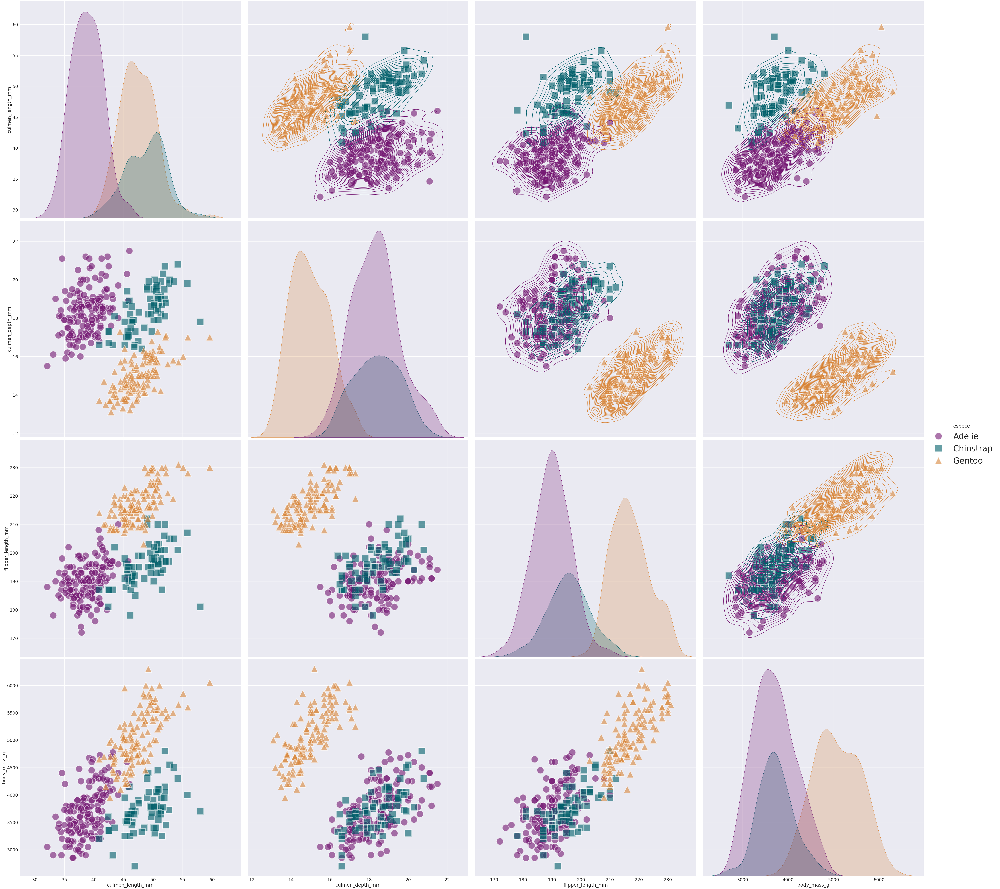

In [38]:
graph = sns.pairplot(
             donnees.drop(columns=qualitatives+[cible]),
             hue='espece', 
             size=16, 
             aspect=1, 
             palette=couleursEspece.values(), 
             plot_kws={"s": 1200,"alpha":0.6}, 
             markers=["o", "s", "^"],   
             # corner=True, 
             diag_kind="kde")
graph.map_upper(sns.kdeplot, levels=24, color=".2");
graph._legend.remove()
graph.add_legend(fontsize='xx-large', title_fontsize='xx-large');
sauvegarderImage('Distribution de l’échantillon des données')

### <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Les trois graphiques les plus  représentatives</div></b>
Les trois graphiques les plus  représentatives  du point de vue de la variance et séparation des classes.

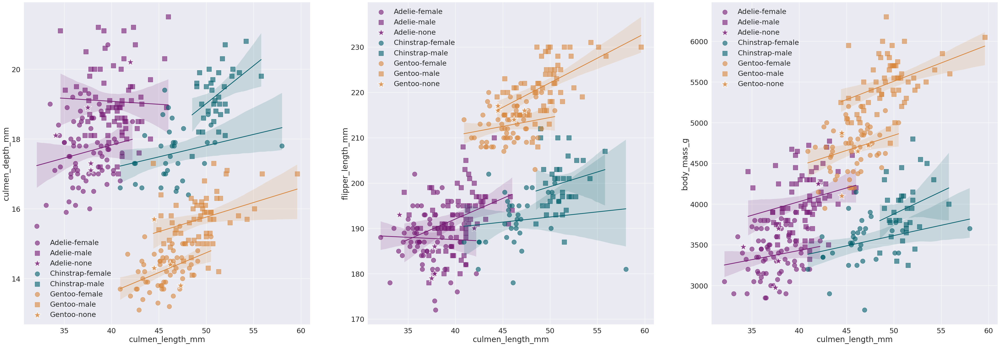

In [39]:
fig,axes = plt.subplots(1,3,figsize=(54,18));
for i,colonne in enumerate(['culmen_depth_mm','flipper_length_mm', 'body_mass_g']):
    for espece in couleursEspece:
        sns.regplot(     data=donnees[(donnees.espece==espece)&(donnees.sex==0)], 
                         x="culmen_length_mm", 
                         y=colonne,
                         color=couleursEspece[espece],
                         scatter_kws={"s": 200,"alpha":0.6}, 
                         marker="o", 
                         label=f'{espece}-female',
                         ax=axes[i])
        sns.regplot(     data=donnees[(donnees.espece==espece)&(donnees.sex==1)], 
                         x="culmen_length_mm", 
                         y=colonne,
                         color=couleursEspece[espece],
                         scatter_kws={"s": 200,"alpha":0.6}, 
                         marker="s",
                         label=f'{espece}-male',
                         ax=axes[i])
        sns.scatterplot( data=donnees[(donnees.espece==espece)&(donnees.sex==2)], 
                         x="culmen_length_mm", 
                         y=colonne,
                         color=couleursEspece[espece],
                         s=600,
                         alpha=0.8,
                         marker="*", 
                         label=f'{espece}-none',
                         legend=True,
                         ax=axes[i])
sauvegarderImage('Les trois graphiques les plus représentatives')        

### <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Corrélation de Pearson</div></b>

<table>        
<tr>                                                                                   
     <th><img src="https://raw.githubusercontent.com/rbizoi/MachineLearning/refs/heads/master/images/rmse.png" ></th>
     <th><img src="https://raw.githubusercontent.com/rbizoi/MachineLearning/refs/heads/master/images/rse.png" ><img src="https://raw.githubusercontent.com/rbizoi/MachineLearning/refs/heads/master/images/correlation_pearson.png" ></th>
</tr> 
</table>
<img src="https://raw.githubusercontent.com/rbizoi/MachineLearning/refs/heads/master/images/correlation_pearson_graphs.png" width="1024">

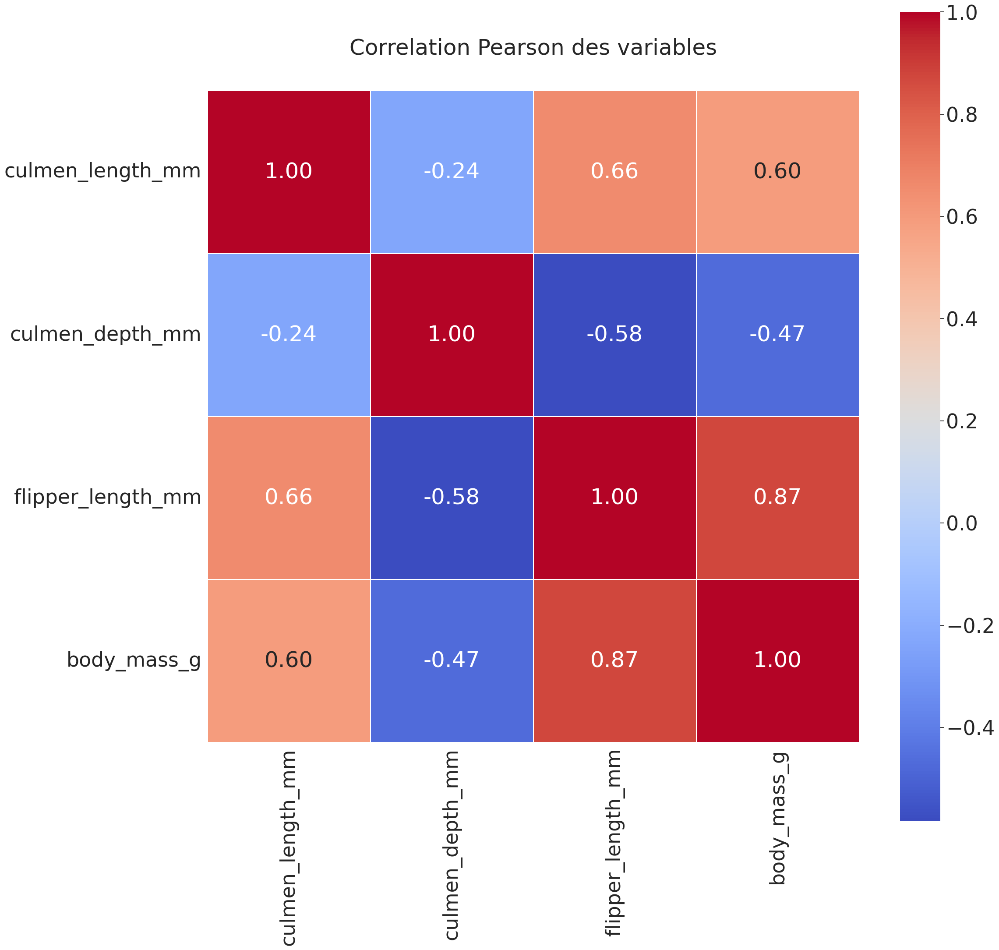

In [40]:
plt.figure(figsize=(24,24))
sns.set(font_scale=3)
plt.title('Correlation Pearson des variables', y=1.05, size=36)
sns.heatmap(donnees[quantitatives].corr(),linewidths=0.3, fmt= '.2f', #vmax=1.0, 
            square=True, cmap='coolwarm', linecolor='white', annot=True)
sauvegarderImage('Correlation Pearson des variables')   
sns.set(font_scale=2)

### <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Analyse des variables corrélés</div></b>

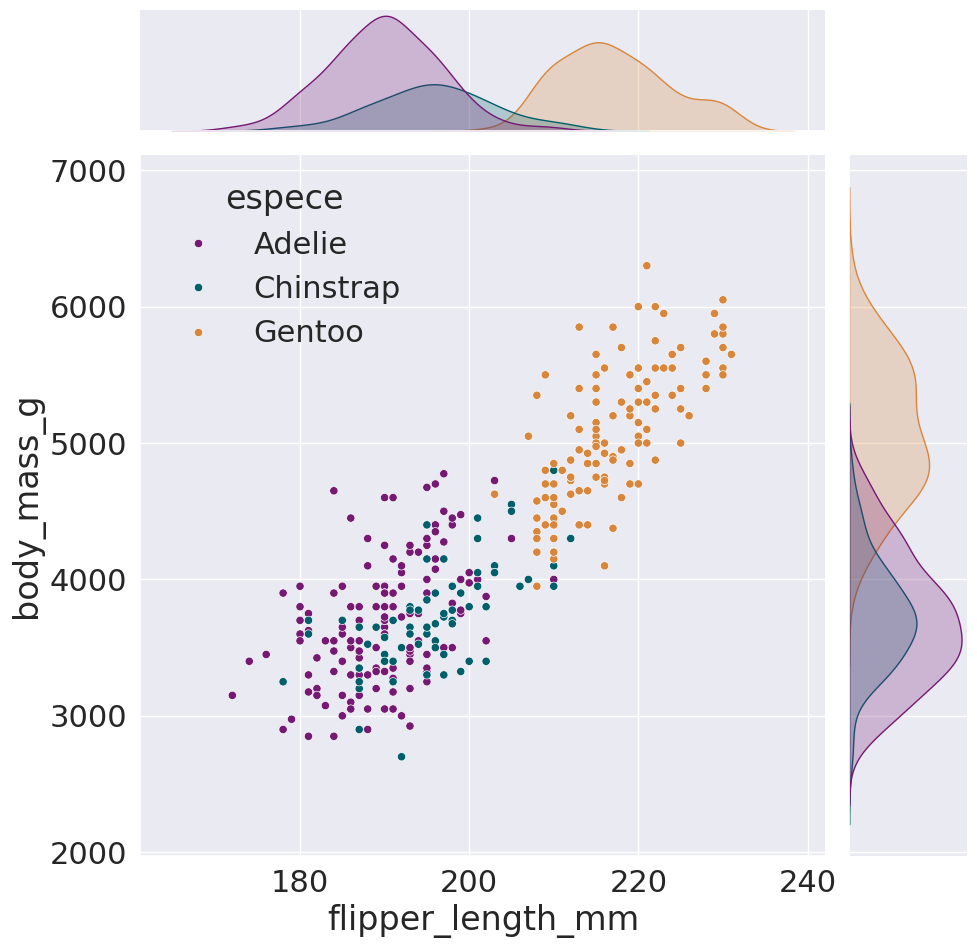

In [41]:
sns.jointplot(data=donnees,
              x='flipper_length_mm',
              y='body_mass_g',
              hue='espece',
              height=10,
              ratio=5, 
              palette=couleursEspece.values());
sauvegarderImage('Analyse des variables corrélés espèces')  

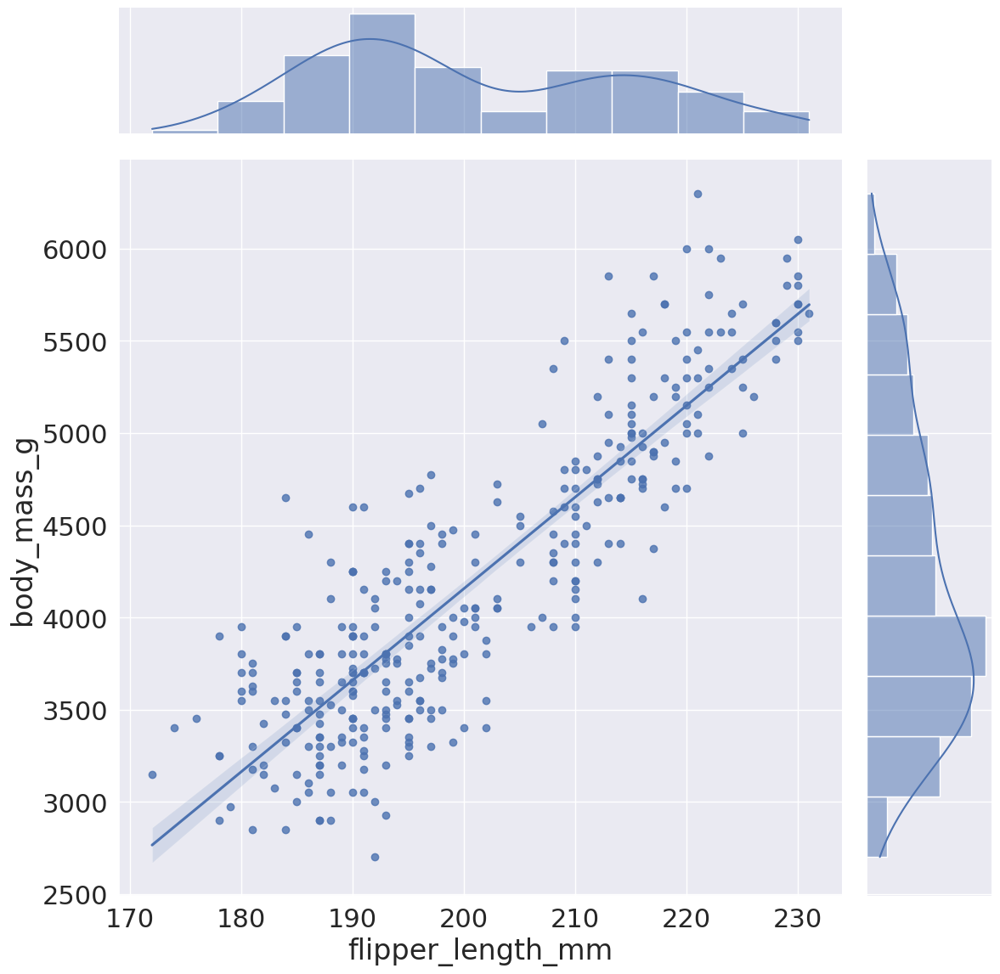

In [42]:
sns.jointplot(data=donnees,
              x='flipper_length_mm',
              y='body_mass_g',
              kind ='reg', #{ "scatter" | "kde" | "hist" | "hex" | "reg" | "resid" }
              # hue='espece',
              height=12,
              ratio=5,);
sauvegarderImage('Analyse des variables corrélés régression')  

### <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Distribution variables quantitatives</div></b>

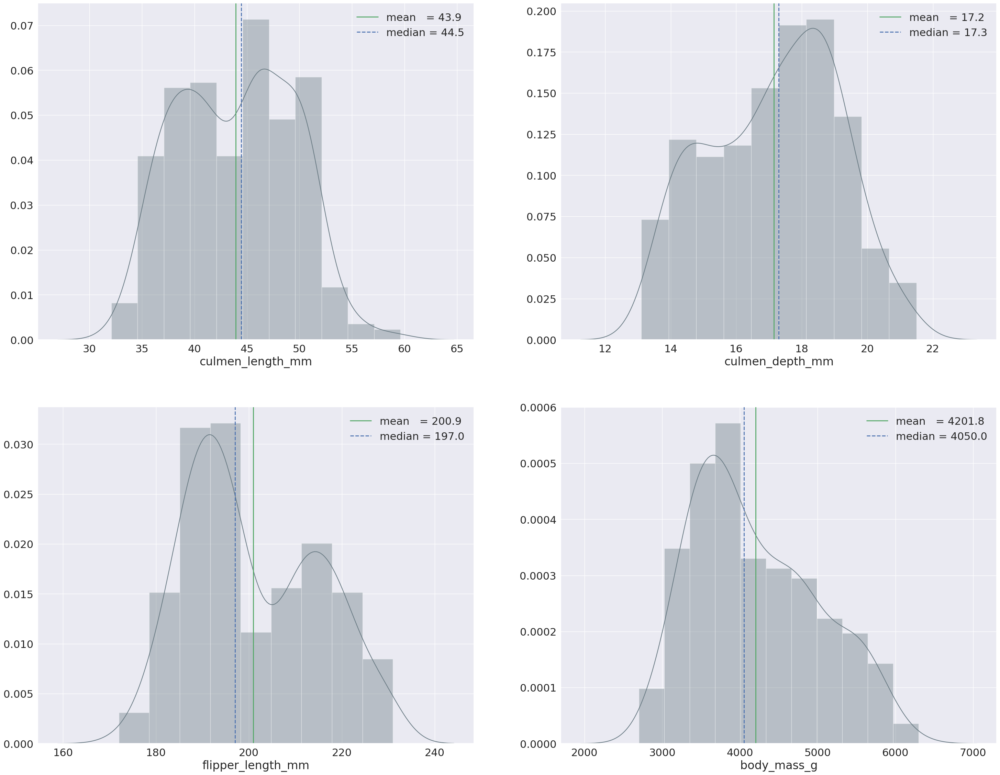

In [43]:
fig, axes = plt.subplots(2,2, figsize=(36,28));
for ax,colonne in zip(axes.ravel(),quantitatives):
    affichageDistribution(donnees[colonne],"#6b7c85",ax)
sauvegarderImage('Distribution Variables Quantitatives')

# <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Separation des données pour l'apprentissage</div></b>

<img src="https://raw.githubusercontent.com/rbizoi/MachineLearning/refs/heads/master/images/echantillonApprentissageTest.png" width="800">

In [44]:
donnees = pd.read_parquet(os.path.join(repertoireDonnees,'donnees_echantillons.parquet'))
X_train, X_test = donnees.loc[donnees['échantillon']=='apprentissage',qualitatives + quantitatives],\
                  donnees.loc[donnees['échantillon']=='test',qualitatives + quantitatives]
y_train, y_test = donnees.loc[donnees['échantillon']=='apprentissage',cible],\
                  donnees.loc[donnees['échantillon']=='test',cible]

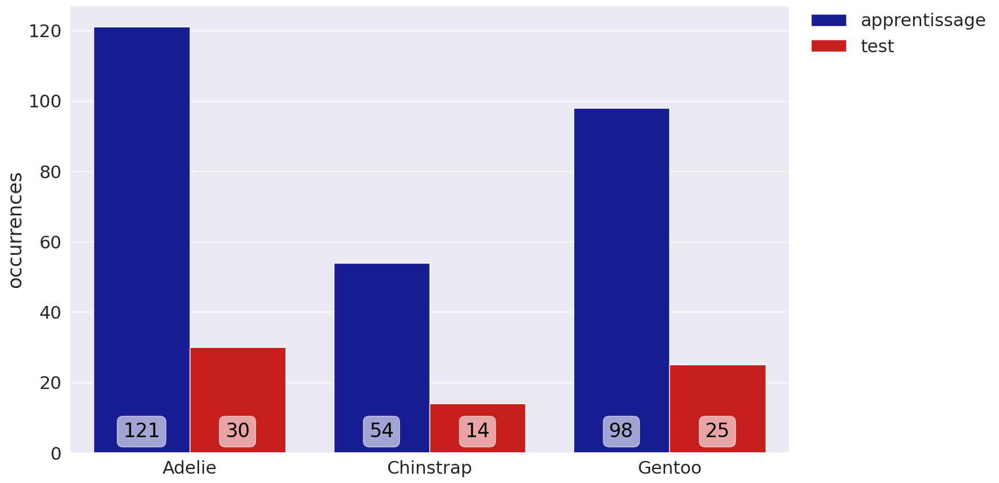

In [45]:
plt.figure(figsize=(16,10))
graph = sns.countplot(x='espece',
                      hue='échantillon',
                      data=donnees.sort_values(['espece','échantillon']), 
                      palette=palette[:2]
                     );

for i,nb in enumerate(donnees.groupby(['espece','échantillon']).species.count()):
    if i%2 == 0 : val = i/2
    delta =  val - 0.2 +(i%2)*0.4
    graph.text(
                delta ,
                6,
                nb,
                color='black',
#                 rotation='vertical',
#                 size='large',
#                 fontsize='large',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.6),
                verticalalignment='center',
                horizontalalignment='center',
               )

graph.set_ylabel('occurrences');
graph.set_xlabel('');
graph.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0);
sauvegarderImage('Distribution des pingouins par espèce et échantillon')

# <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Déclaration des classifieurs </div></b>

In [85]:
names = [
            'Random_Forest',
            'AdaBoost',
            # 'LightGBM',
            # 'XGBoost',
            'LogisticRegression',
            'Stochastic_GD',
            'Gaussian_Process',
            'Nearest_Neighbors',
            'Linear_SVM', 
            'Radial_NuSVM',
            'Poly_NuSVM',
            'GaussianNaiveBayes',
            'QuadraticDiscriminant',
            'Neural_Net'
        ]

arbres = 24
classifiers = [
            RandomForestClassifier(
                max_depth=6,
                max_features=3,
                min_samples_split=4,
                n_estimators=arbres,
                n_jobs=-1
            ),
            AdaBoostClassifier(
                n_estimators=arbres
            ),    
            # LGBMClassifier(
            #     learning_rate=0.1,
            #     n_estimators=arbres,
            #     num_leaves=20,
            #     reg_alpha=0.1,
            #     reg_lambda=20,
            # ),
            # XGBClassifier(
            #     objective='binary:logistic',
            #     eval_metric='auc',
            #     n_estimators=arbres,
            #     max_depth=6,
            #     use_label_encoder=False
            # ),
            LogisticRegression(
                C=0.81113,
                max_iter=800,
                penalty='l2',
                solver='lbfgs',
                n_jobs=-1
            ),
            SGDClassifier(
                loss='log', 
                alpha=0.01, 
                max_iter=200, 
                fit_intercept=True
            ),
            GaussianProcessClassifier(
                n_jobs=-1
            ),
            KNeighborsClassifier(
                algorithm='ball_tree',
                n_neighbors=17,
                p=1,
                weights='distance',
                n_jobs=-1
            ),
            SVC(
                kernel="linear" , 
                C=0.025, 
                probability=True),
            NuSVC(
                kernel="rbf",
                gamma=0.5,
                nu=0.195,
                probability=True,
            ),
            NuSVC(
                kernel="poly",
                degree=3,
                nu=0.1,
                probability=True,
            ),
            GaussianNB(),
            QuadraticDiscriminantAnalysis(),
            MLPClassifier(
                alpha=1
            ),
        ]

classifieursDict = {name:OneVsRestClassifier(clf) for name, clf in zip(names, classifiers)}           

In [86]:
classifieursDict.pop('Stochastic_GD'),classifieursDict.pop('QuadraticDiscriminant')

(OneVsRestClassifier(estimator=SGDClassifier(alpha=0.01, loss='log',
                                             max_iter=200)),
 OneVsRestClassifier(estimator=QuadraticDiscriminantAnalysis()))

In [87]:
classifieursDict

{'Random_Forest': OneVsRestClassifier(estimator=RandomForestClassifier(max_depth=6,
                                                      max_features=3,
                                                      min_samples_split=4,
                                                      n_estimators=24,
                                                      n_jobs=-1)),
 'AdaBoost': OneVsRestClassifier(estimator=AdaBoostClassifier(n_estimators=24)),
 'LogisticRegression': OneVsRestClassifier(estimator=LogisticRegression(C=0.81113, max_iter=800,
                                                  n_jobs=-1)),
 'Gaussian_Process': OneVsRestClassifier(estimator=GaussianProcessClassifier(n_jobs=-1)),
 'Nearest_Neighbors': OneVsRestClassifier(estimator=KNeighborsClassifier(algorithm='ball_tree',
                                                    n_jobs=-1, n_neighbors=17,
                                                    p=1, weights='distance')),
 'Linear_SVM': OneVsRestClassifier(estimator=SVC

# <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Choix des classifieurs</div></b> 

In [83]:
def executeApprentissageChoixClassifieurs(classifieursDict,
                                          X_train,
                                          y_train,
                                          X_test,
                                          y_test,
                                          label_dict,
                                          couleurs,
                                          nom_essai = 'initial'
                                         ):
    
    def afficheCourbes(vraisPositifs,fauxPositifs,aucROCt,precisions,sensibilites,avgPrecRec,nbClasses,lw,nom,label_dict):
        plt.figure(figsize=(24, 24));
        for i, color in zip(range(nbClasses), palette):
            plt.plot(fauxPositifs[i], vraisPositifs[i], color=color, lw=lw,
                     label=' ' + label_dict[i] + ' (AUC = {1:0.8f})'
                                                             ''.format(i, aucROCt[i]))
    
        plt.plot([0, 1], [0, 1], 'k--', lw=lw)
        plt.xlim([-0.05, 1.05])
        plt.ylim([-0.05, 1.05])
        plt.xlabel('Taux de faux Positifs-(1 - Spécificité) = VN / (FP + VN)',size=18)
        plt.ylabel('Taux de vrais positifs-Sensibilité = VP / (VP + FN)',size=18)
        plt.title('Courbe ROC (Receiver Operating Caracteristic)',size=20)
        plt.legend(loc="lower right"); #, fontsize='large'

        plt.figure(figsize=(24,24));

        f_scores = np.linspace(0.2, 0.9, num=8)
        for f_score in f_scores:
            x = np.linspace(0.01, 1)
            y = f_score * x / (2 * x - f_score)
            l, = plt.plot(x[y >= 0], y[y >= 0], color='gray', alpha=0.2)
            plt.annotate('f1={0:0.1f}'.format(f_score), xy=(0.9, y[45] + 0.02))

        for i, color in zip(range(nbClasses), palette):
            plt.step(sensibilites[i], 
                         precisions[i], 
                         where='post', 
                         color=color, 
                         lw=lw, 
                         label=f"{label_dict[i]}(APR = {avgPrecRec[(nom,label_dict[i])]:0.8f})"
                    )
            plt.fill_between(sensibilites[i], precisions[i], step='post', alpha=0.05)            

            # plt.plot(fauxPositifs[i], vraisPositifs[i], color=color, lw=lw,
            #          label=' ' + label_dict[i] + ' (AUC = {1:0.8f})'
            #                                                  ''.format(i, aucROCt[i]))        

        plt.plot([0, 1], [0, 1], 'k--', lw=lw)
        plt.xlim([-0.05, 1.05])
        plt.ylim([-0.05, 1.05])        
        plt.xlabel('Sensibilité/Rappel(Recall) = VP / (VP + FN)',size=18)
        plt.ylabel('Précision = VP / (VP + FP)',size=18)        
        plt.title('Courbe Précision-Rappel -- '+nom,size=20)
        plt.legend(loc="lower right") # , fontsize = 'large'

    
    
    #     sauvegarderImage('La courbe ROC multi-class -- ' + nom)
        # plt.show()
    
    cvF1, cvF1SD, cvAccuracy, cvAccSD, aucROC, avgPrecRec, accuracy, balanced_accuracy, logloss, hammingloss, precision, sensibilite, \
    f1, f2, f05, jaccard, vrais_negatifs, faux_positifs, faux_negatifs, vrais_positifs, total_positifs, aucROCtn = \
        dict(), dict(), dict(), dict(), dict(), dict(), dict(), dict(), dict(), dict(), dict(), dict(),\
        dict(), dict(), dict(), dict(), dict(), dict(), dict(), dict(), dict(), dict()
    #
    oneloss, precision_micro, precision_macro, precision_weighted, \
    sensibilite_macro, sensibilite_micro, sensibilite_weighted, \
    f1_micro, f1_macro, f1_weighted,f2_micro,f2_macro,f2_weighted,f05_micro,f05_macro,f05_weighted = \
        dict(), dict(), dict(), dict(), dict(), dict(), dict(), dict(), \
        dict(), dict(), dict(), dict(), dict(), dict(), dict(), dict()
    
    fauxPositifs, vraisPositifs, precisions, sensibilites, aucROCt, pr_auc, tauxROC, tauxPR = dict(), dict(), dict(), dict(), dict(), dict(), dict(), dict()        


    lw = 1
    # couleurs    = sns.hls_palette(len(classifieursDict.keys()), l=.4, s=.9)
    nbClasses   = len(y_train.sort_values().unique())
    listClasses = y_train.sort_values().unique()
    
    y_trainA = label_binarize(y_train, classes=listClasses)
    y_testA  = label_binarize(y_test, classes=listClasses)
    
    plt.figure(figsize=(18,18))
    
    for nom in classifieursDict:    
        t1 = time.time()  
        classifier = classifieursDict[nom]
    
        classifier.fit(X_train, y_train)
    
        y_score     = classifier.predict_proba(X_test)
        y_pred      = classifier.predict(X_test)
        y_predA     = label_binarize(y_pred, classes=listClasses)
    
        accuracy[(nom, 'global')]              = accuracy_score(y_test, y_pred)
        balanced_accuracy[(nom, 'global')]     = balanced_accuracy_score(y_test, y_pred)
        precision[(nom, 'global')]             = precision_score(y_test, y_pred, average='weighted')
        sensibilite[(nom, 'global')]           = recall_score(y_test, y_pred, average='weighted')
    
        f1[(nom, 'global')]                    = f1_score(y_test, y_pred, average='weighted')
        f2[(nom, 'global')]                    = fbeta_score(y_test, y_pred, beta=2, average='weighted')
        f05[(nom, 'global')]                   = fbeta_score(y_test, y_pred, beta=0.5, average='weighted')
    
        vrais_negatifs[(nom, 'global')]        = 0
        faux_positifs [(nom, 'global')]        = 0
        faux_negatifs [(nom, 'global')]        = 0
        vrais_positifs[(nom, 'global')]        = 0
        total_positifs[(nom, 'global')]        = 0
    
    
        aucROC[(nom, 'global')] = roc_auc_score(y_test, y_score, multi_class='ovr')
        
        for i in range(nbClasses):
            fauxPositifs[i], vraisPositifs[i], tauxROC[i] = roc_curve(y_testA[:, i], y_score[:, i])
            aucROCt[i]                                    = auc(fauxPositifs[i], vraisPositifs[i])
            precisions[i], sensibilites[i], tauxPR[i]     = precision_recall_curve(y_testA[:, i], y_score[:, i])
    
            aucROC[(nom, label_dict[i])]                = aucROCt[i]
            avgPrecRec[(nom, label_dict[i])]            = average_precision_score(y_testA[:, i], y_score[:, i])
            accuracy[(nom, label_dict[i])]              = accuracy_score(y_testA[:, i], y_predA[:, i])
            balanced_accuracy[(nom, label_dict[i])]     = balanced_accuracy_score(y_testA[:, i],y_predA[:, i])
            logloss[(nom, label_dict[i])]               = log_loss(y_testA[:, i], y_predA[:, i])
            hammingloss[(nom, label_dict[i])]           = hamming_loss(y_testA[:, i], y_predA[:, i])
            precision[(nom, label_dict[i])]             = precision_score(y_testA[:, i], y_predA[:, i])
            sensibilite[(nom, label_dict[i])]           = recall_score(y_testA[:, i], y_predA[:, i])
            f1[(nom, label_dict[i])]                    = f1_score(y_testA[:, i], y_predA[:, i])
            f2[(nom, label_dict[i])]                    = fbeta_score(y_testA[:, i], y_predA[:, i], beta=2)
            f05[(nom, label_dict[i])]                   = fbeta_score(y_testA[:, i], y_predA[:, i], beta=0.5)
          
            jaccard[(nom, label_dict[i])]               = jaccard_score(y_testA[:, i], y_predA[:, i])
            vrais_negatifs[(nom, label_dict[i])]        = confusion_matrix(y_testA[:, i], y_predA[:, i])[0, 0]
            faux_positifs[(nom, label_dict[i])]         = confusion_matrix(y_testA[:, i], y_predA[:, i])[0, 1]
            faux_negatifs[(nom, label_dict[i])]         = confusion_matrix(y_testA[:, i], y_predA[:, i])[1, 0]
            vrais_positifs[(nom, label_dict[i])]        = confusion_matrix(y_testA[:, i], y_predA[:, i])[1, 1]
            total_positifs[(nom, label_dict[i])]        = vrais_positifs[(nom, label_dict[i])] + faux_negatifs [(nom, label_dict[i])]
            vrais_negatifs[(nom, 'global')]              += vrais_negatifs[(nom, label_dict[i])]
            faux_positifs [(nom, 'global')]              += faux_positifs [(nom, label_dict[i])]
            faux_negatifs [(nom, 'global')]              += faux_negatifs [(nom, label_dict[i])]
            vrais_positifs[(nom, 'global')]              += vrais_positifs[(nom, label_dict[i])]
        
    
        total_positifs[(nom, 'global')] = vrais_positifs[(nom, 'global')] + faux_negatifs [(nom, 'global')]
    
    
        fauxPositifs["micro"], vraisPositifs["micro"], _ = roc_curve(y_testA.ravel(), y_score.ravel())
        aucROCt["micro"]                                 = auc(fauxPositifs["micro"], vraisPositifs["micro"])
    
        listFauxPositifs = np.unique(np.concatenate([fauxPositifs[i] for i in range(nbClasses)]))
        moyenneVraisPositifs = np.zeros_like(listFauxPositifs)
        for i in range(nbClasses):
            moyenneVraisPositifs += np.interp(listFauxPositifs, fauxPositifs[i], vraisPositifs[i])
    
        moyenneVraisPositifs /= nbClasses
    
        fauxPositifs["macro"], vraisPositifs["macro"] = listFauxPositifs, moyenneVraisPositifs
        aucROCt["macro"] = auc(fauxPositifs["macro"], vraisPositifs["macro"])
        # aucROC[(nom, 'global')] = aucROCt["macro"]  # (aucROCt["micro"],aucROCt["macro"])
    
        avgPrecRec[(nom, 'global')] = average_precision_score(y_testA.ravel(), y_score.ravel(), average='weighted')
        
        afficheCourbes(vraisPositifs,fauxPositifs,aucROCt,precisions,sensibilites,avgPrecRec,nbClasses,lw,nom,label_dict);

        print(f'{nom:21s}'+(' %.4f' % accuracy[(nom, 'global')]).lstrip('0'),end='\t--\t')
        print ("Area under the ROC curve : %0.4f" % aucROC[(nom, 'global')],end='\t--\t')
        print('Exécution  :'+('%.2fs' % (time.time() - t1)).lstrip('0'))
        
    resultats = pd.DataFrame(pd.Series(aucROC), columns=["aucROC"])
    resultats["avgPrecRec"]              = pd.Series(avgPrecRec)
    resultats["f1"]                      = pd.Series(f1)
    resultats["f2"]                      = pd.Series(f2)
    resultats["f05"]                     = pd.Series(f05)
    resultats["accuracy"]                = pd.Series(accuracy)
    
    resultats["precision"]               = pd.Series(precision)
    resultats["sensibilite"]             = pd.Series(sensibilite)
    resultats["vrais_positifs"]          = pd.Series(vrais_positifs)
    resultats["vrais_negatifs"]          = pd.Series(vrais_negatifs)
    resultats["faux_positifs"]           = pd.Series(faux_positifs)
    resultats["faux_negatifs"]           = pd.Series(faux_negatifs)
    resultats["total_positifs"]          = pd.Series(total_positifs)
    
    resultats.reset_index(inplace=True)
    resultats.rename(columns={"level_0": "Classifieur", "level_1": "Classe"}, inplace=True)
    resultats['essai'] = nom_essai
    return resultats

Random_Forest         1.0000	--	Area under the ROC curve : 1.0000	--	Exécution  :.53s
AdaBoost              0.9710	--	Area under the ROC curve : 1.0000	--	Exécution  :.09s
LogisticRegression    1.0000	--	Area under the ROC curve : 1.0000	--	Exécution  :.65s
Gaussian_Process      0.7536	--	Area under the ROC curve : 0.9200	--	Exécution  :.58s
Nearest_Neighbors     0.8551	--	Area under the ROC curve : 0.9386	--	Exécution  :.21s
Linear_SVM            1.0000	--	Area under the ROC curve : 1.0000	--	Exécution  :.72s
Radial_NuSVM          0.4928	--	Area under the ROC curve : 0.9197	--	Exécution  :.09s
Poly_NuSVM            0.0870	--	Area under the ROC curve : 0.7445	--	Exécution  :.05s
GaussianNaiveBayes    0.9710	--	Area under the ROC curve : 0.9964	--	Exécution  :.04s
Neural_Net            0.7826	--	Area under the ROC curve : 0.8824	--	Exécution  :.18s


<Figure size 1800x1800 with 0 Axes>

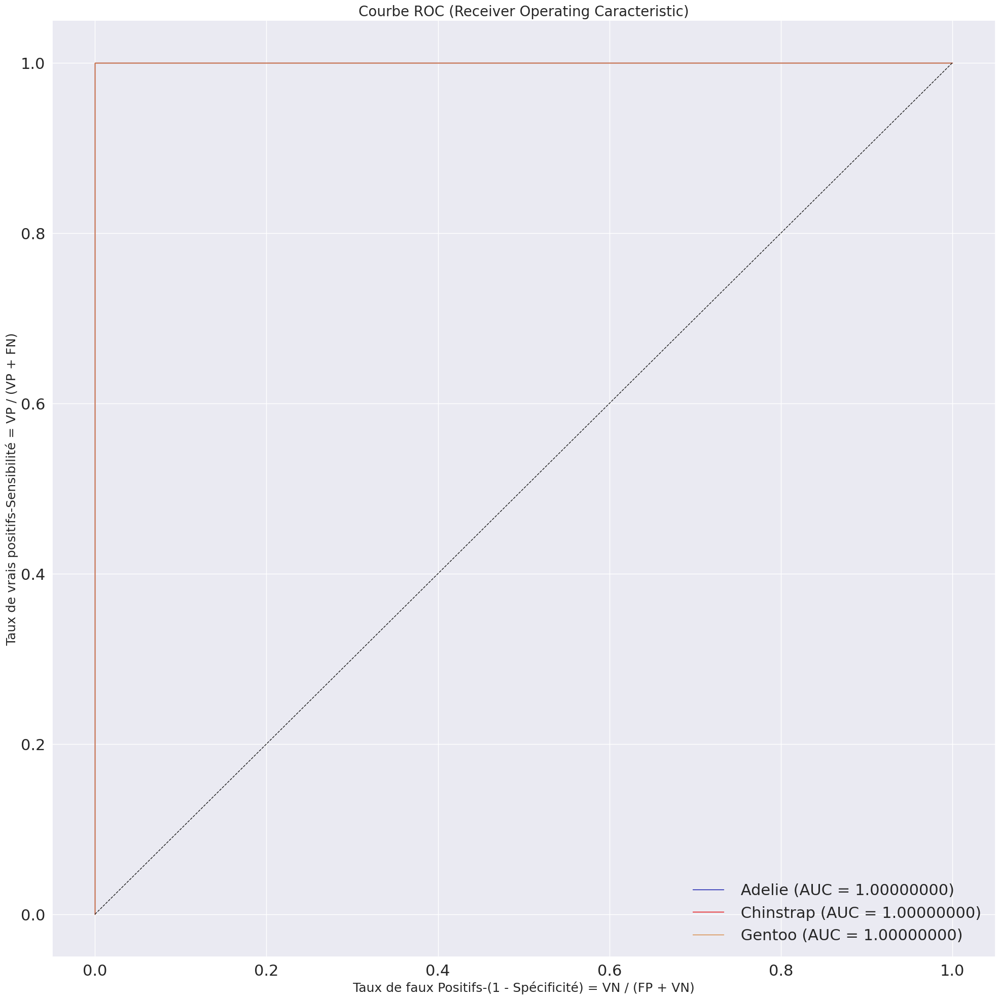

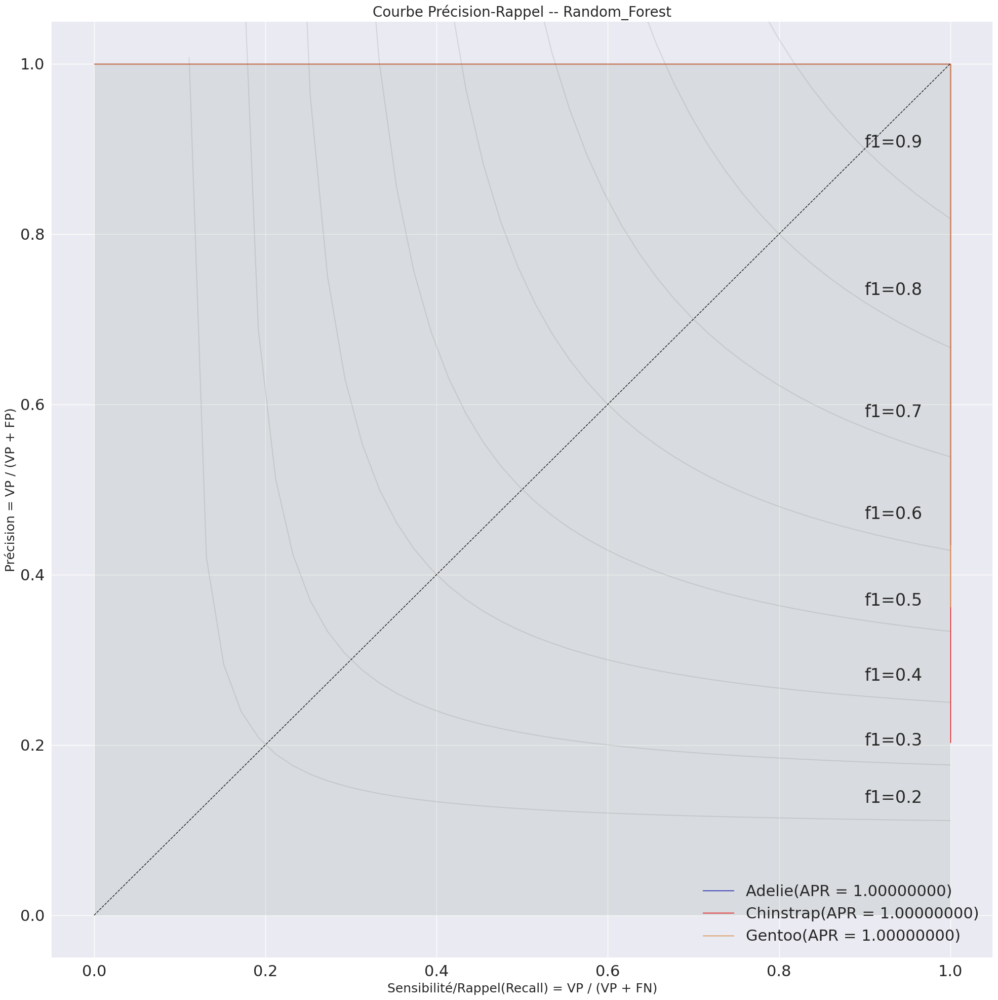

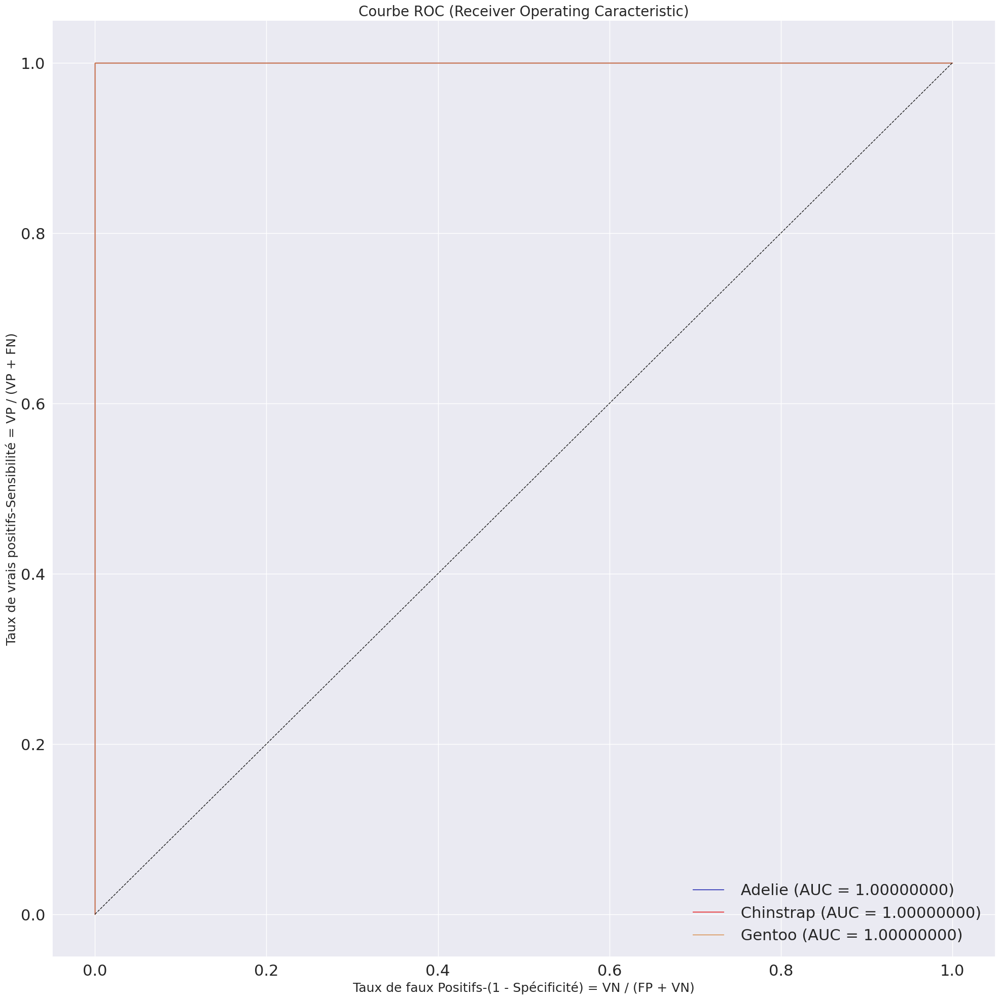

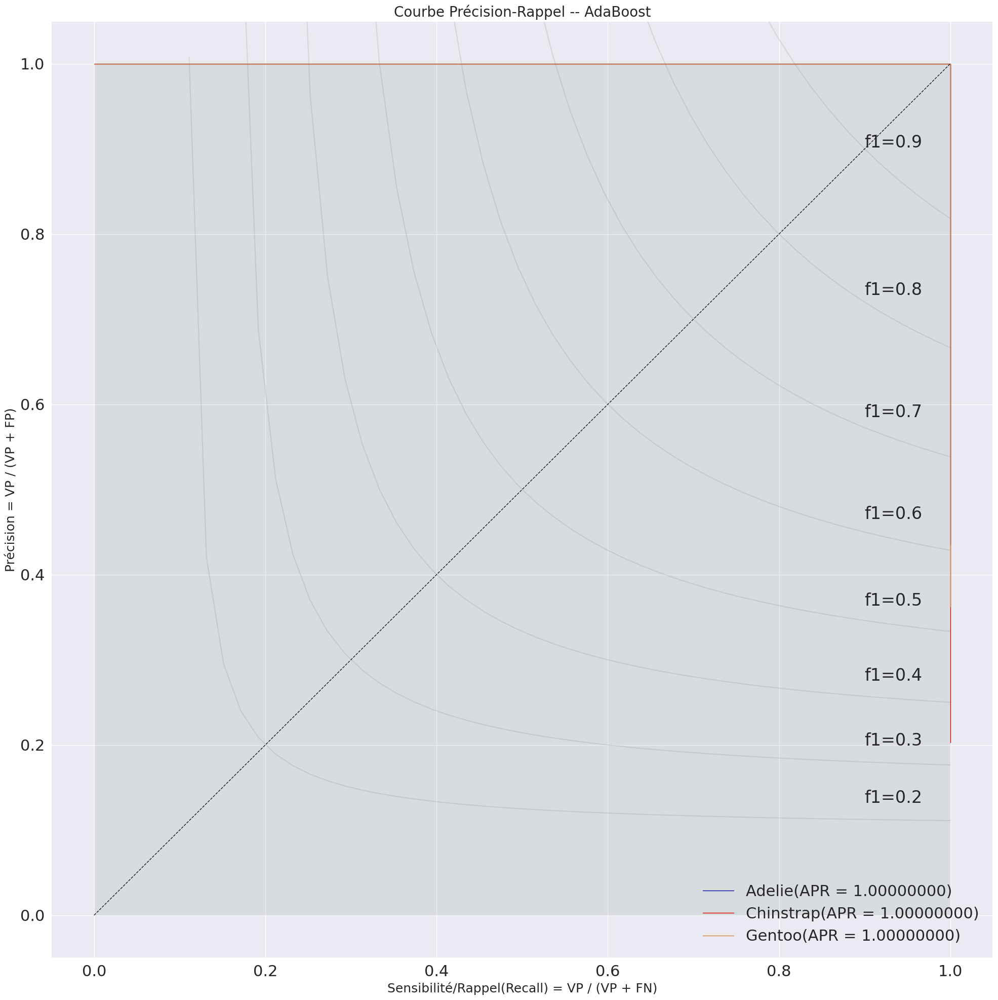

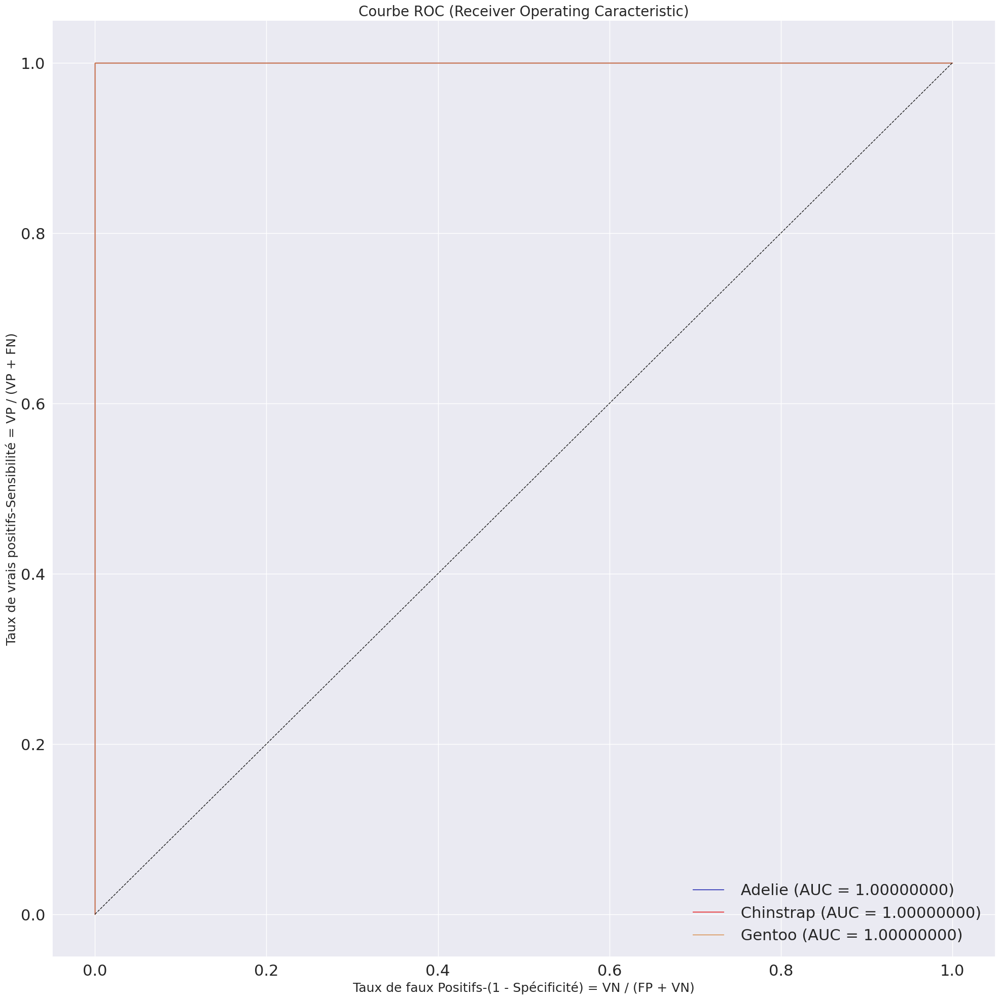

...

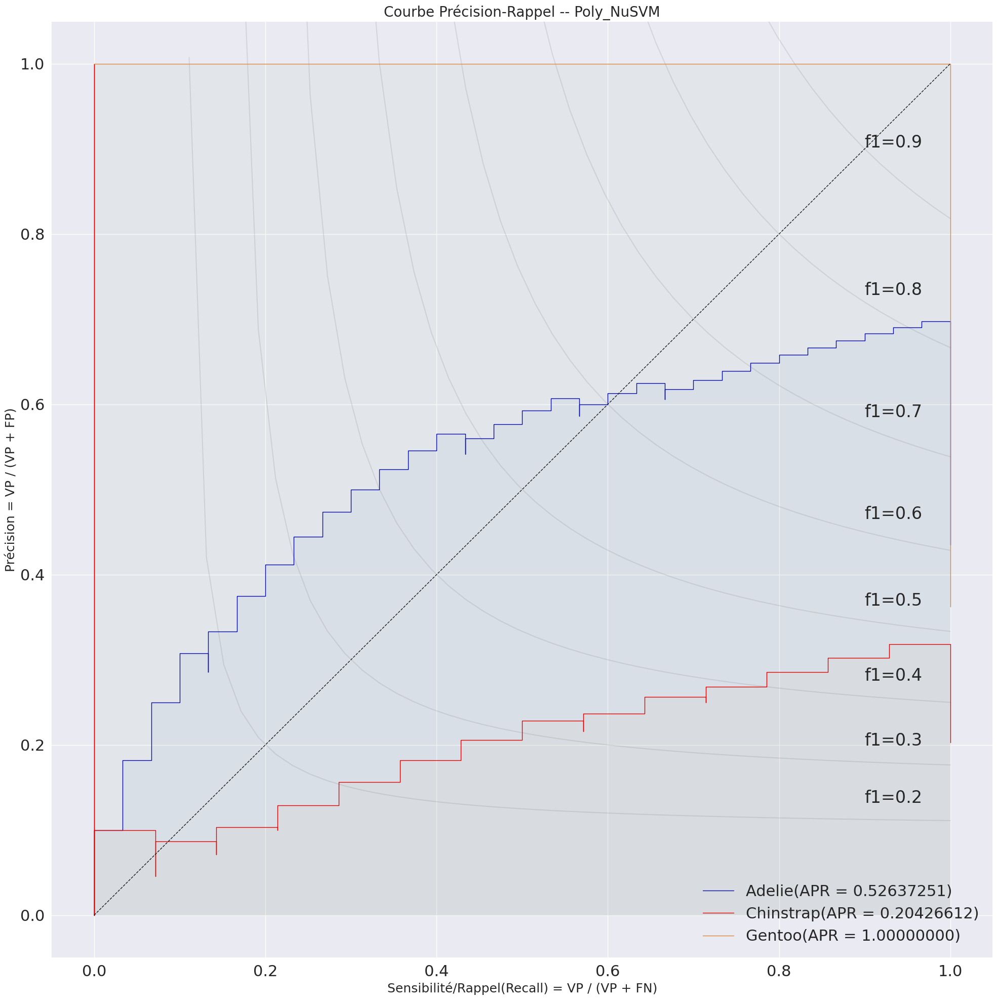

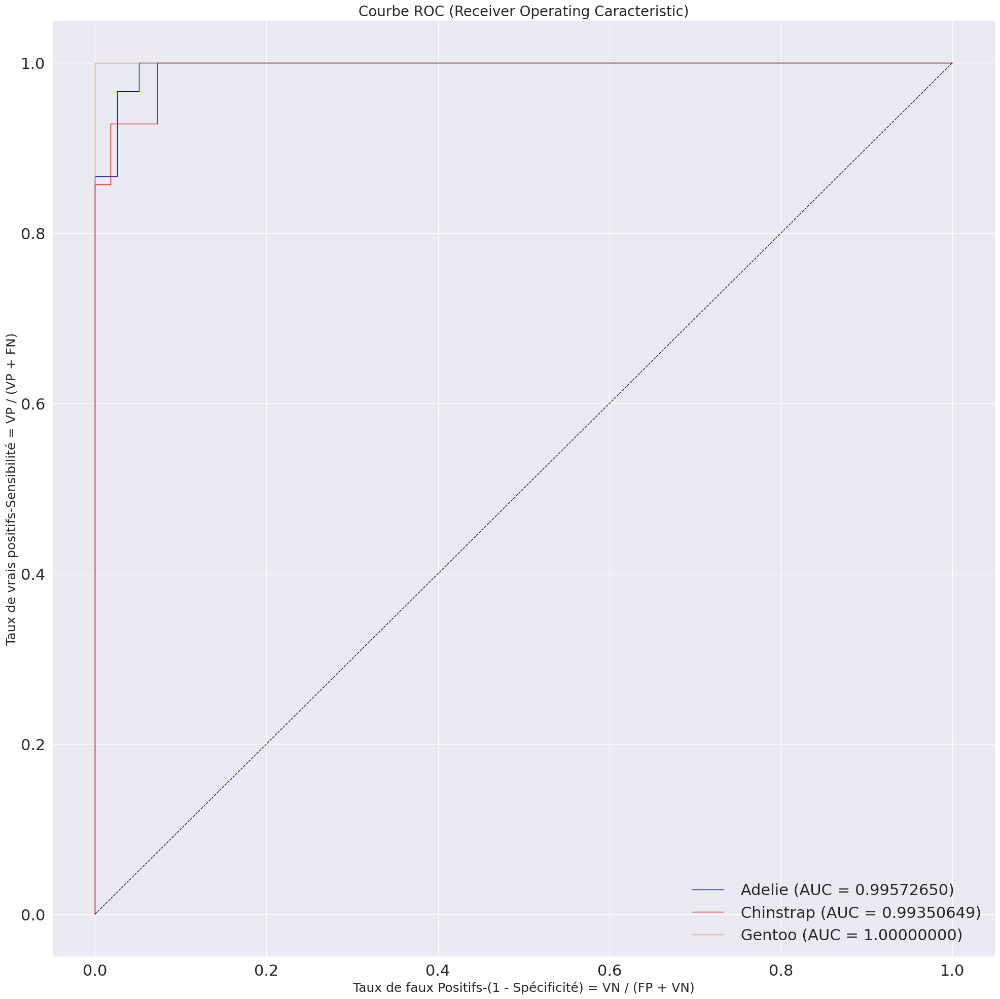

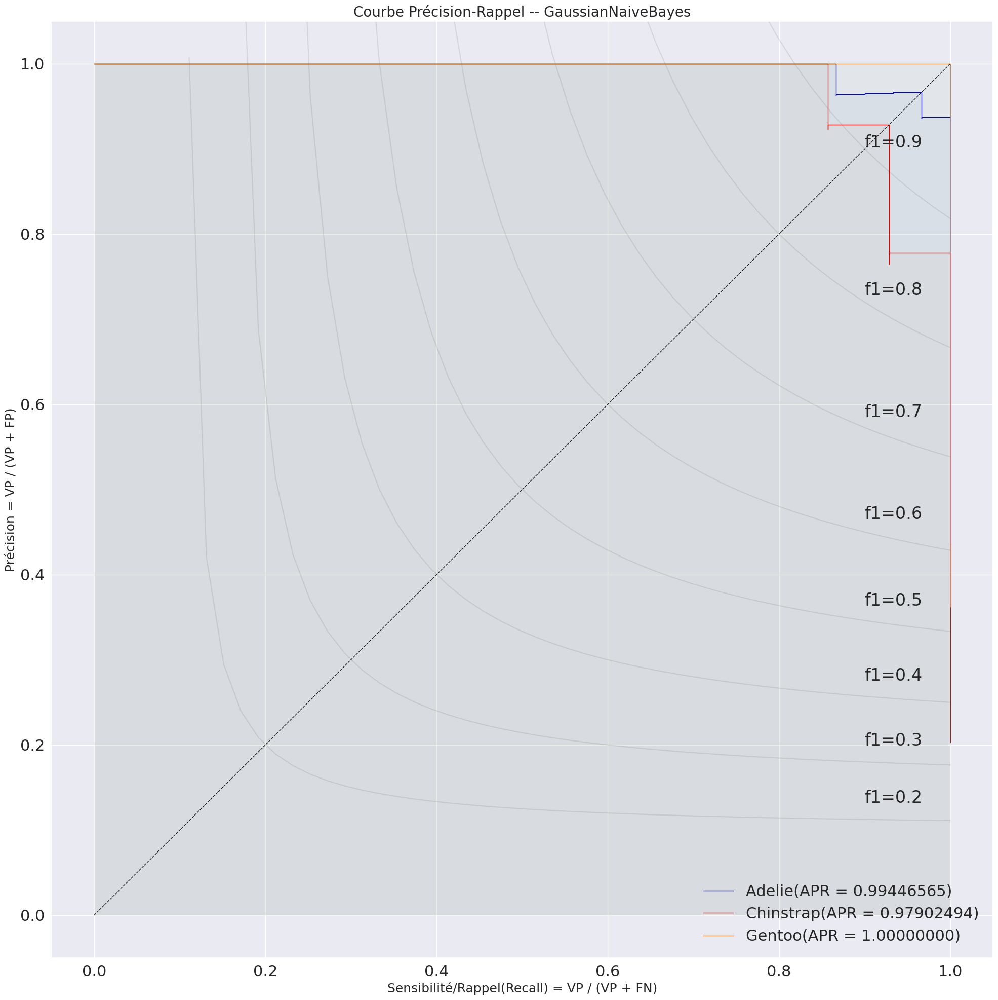

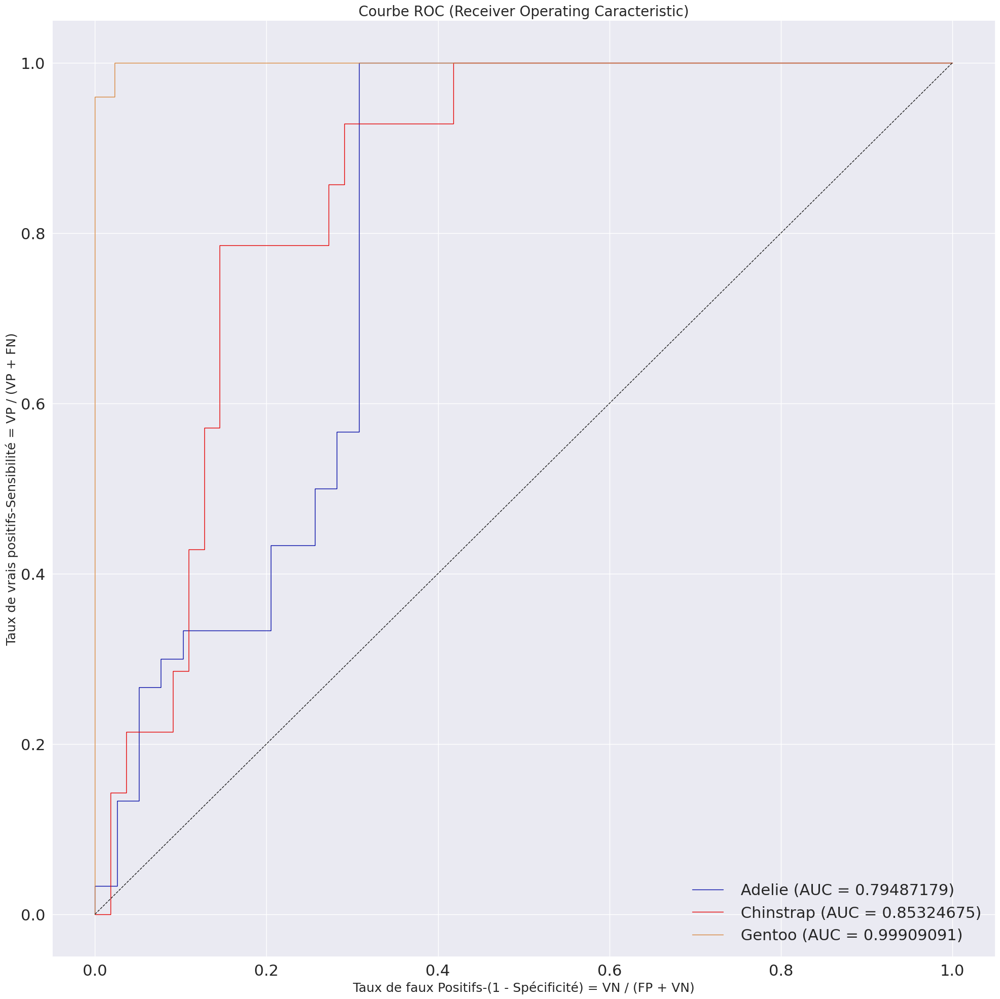

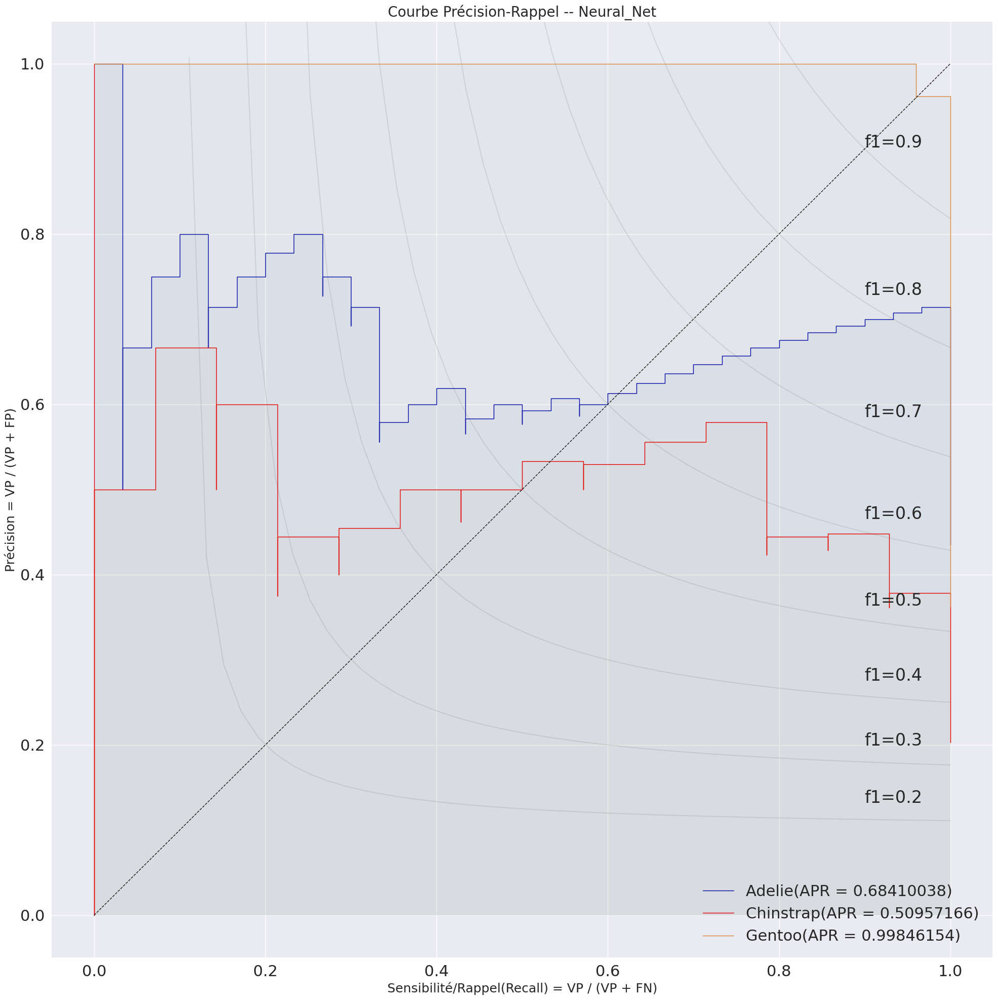

In [88]:
resultats = executeApprentissageChoixClassifieurs(classifieursDict,X_train,y_train,X_test,y_test,dictR_species,couleurs=couleursEspece.values())

In [90]:
resultats.loc[resultats.Classe == 'global',
              ['essai','Classifieur', 'Classe', 'aucROC', 
               'avgPrecRec', 'f1', 'f2', 'f05',
               'accuracy', 'precision', 'sensibilite']].sort_values('f1',ascending=False)

,essai,Classifieur,Classe,aucROC,avgPrecRec,f1,f2,f05,accuracy,precision,sensibilite
0,initial,Random_Forest,global,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
8,initial,LogisticRegression,global,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
20,initial,Linear_SVM,global,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
4,initial,AdaBoost,global,1.000000,0.999178,0.970907,0.970765,0.971674,0.971014,0.972538,0.971014
32,initial,GaussianNaiveBayes,global,0.996411,0.995944,0.970367,0.970409,0.971441,0.971014,0.972826,0.971014
16,initial,Nearest_Neighbors,global,0.938637,0.945048,0.841897,0.847617,0.844469,0.855072,0.852657,0.855072
12,initial,Gaussian_Process,global,0.920027,0.843408,0.746918,0.744142,0.768771,0.753623,0.794475,0.753623
36,initial,Neural_Net,global,0.882403,0.762451,0.696985,0.745401,0.655549,0.782609,0.631028,0.782609
24,initial,Radial_NuSVM,global,0.919742,0.751396,0.379292,0.423089,0.428134,0.492754,0.765886,0.492754
28,initial,Poly_NuSVM,global,0.744533,0.605158,0.065475,0.076407,0.057776,0.086957,0.053735,0.086957


# <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Centrage et réduction des données</div></b> 

<table>
<tr>
<th><img src="https://raw.githubusercontent.com/rbizoi/IntelligenceEnDonneesDeSante/refs/heads/main/images/moyenne.png"></th>
<th><img src="https://raw.githubusercontent.com/rbizoi/IntelligenceEnDonneesDeSante/refs/heads/main/images/ecart_type.png"></th>
<th><img src="https://raw.githubusercontent.com/rbizoi/IntelligenceEnDonneesDeSante/refs/heads/main/images/centrage_reduction.png"></th>
</tr>
</table>

In [91]:
modelStd = StandardScaler()
modelStd.fit(donnees[quantitatives])

StandardScaler()

In [92]:
X_train[quantitatives]

,culmen_length_mm,culmen_depth_mm,flipper_length_mm,body_mass_g
0,39.1,18.7,181.0,3750.0
1,39.5,17.4,186.0,3800.0
2,40.3,18.0,195.0,3250.0
4,36.7,19.3,193.0,3450.0
5,39.3,20.6,190.0,3650.0
...,...,...,...,...
335,55.1,16.0,230.0,5850.0
337,48.8,16.2,222.0,6000.0
341,50.4,15.7,222.0,5750.0
342,45.2,14.8,212.0,5200.0


In [93]:
X_train[quantitatives] = modelStd.transform(X_train[quantitatives])
X_test[quantitatives] = modelStd.transform(X_test[quantitatives])

Random_Forest         1.0000	--	Area under the ROC curve : 1.0000	--	Exécution  :.38s
AdaBoost              0.9710	--	Area under the ROC curve : 1.0000	--	Exécution  :.09s
LogisticRegression    0.9855	--	Area under the ROC curve : 1.0000	--	Exécution  :.50s
Gaussian_Process      1.0000	--	Area under the ROC curve : 1.0000	--	Exécution  :.52s
Nearest_Neighbors     0.9855	--	Area under the ROC curve : 1.0000	--	Exécution  :.21s
Linear_SVM            0.9710	--	Area under the ROC curve : 0.9988	--	Exécution  :.05s
Radial_NuSVM          1.0000	--	Area under the ROC curve : 1.0000	--	Exécution  :.06s
Poly_NuSVM            1.0000	--	Area under the ROC curve : 1.0000	--	Exécution  :.05s
GaussianNaiveBayes    0.9565	--	Area under the ROC curve : 1.0000	--	Exécution  :.04s
Neural_Net            1.0000	--	Area under the ROC curve : 1.0000	--	Exécution  :.35s


<Figure size 1800x1800 with 0 Axes>

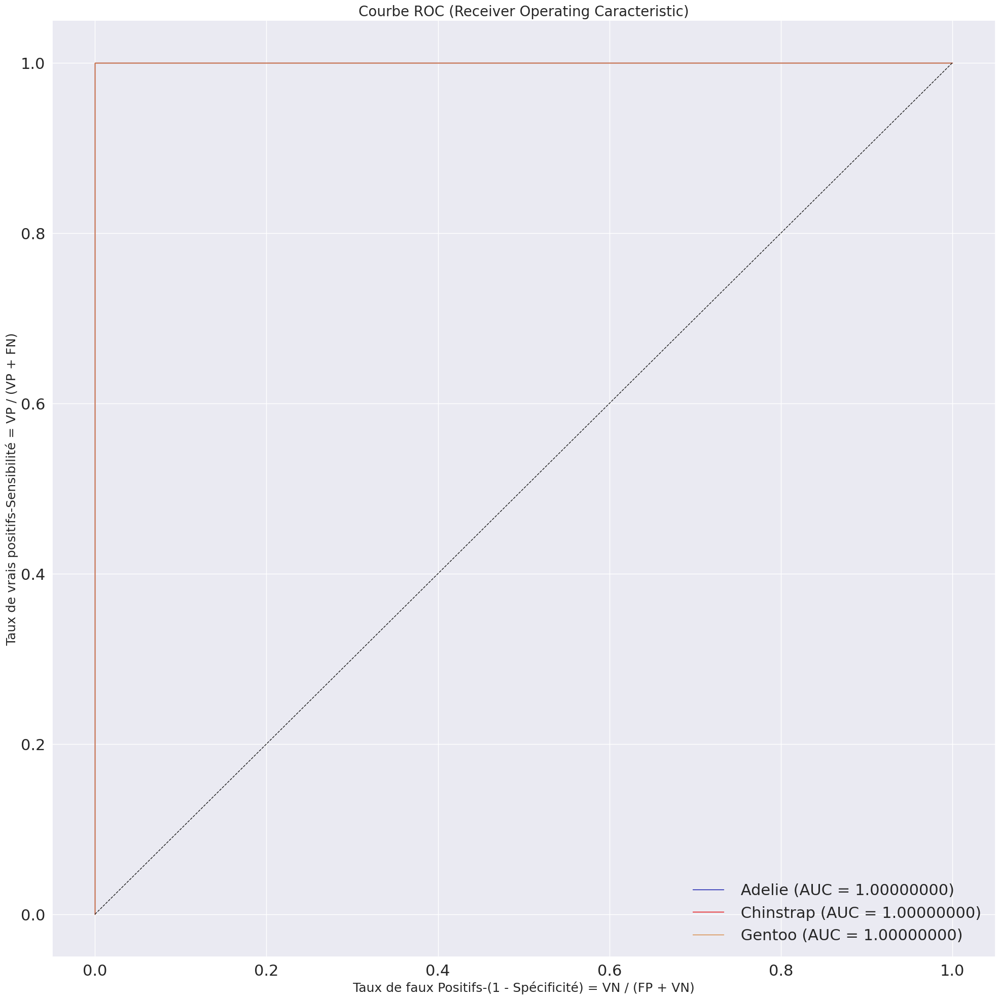

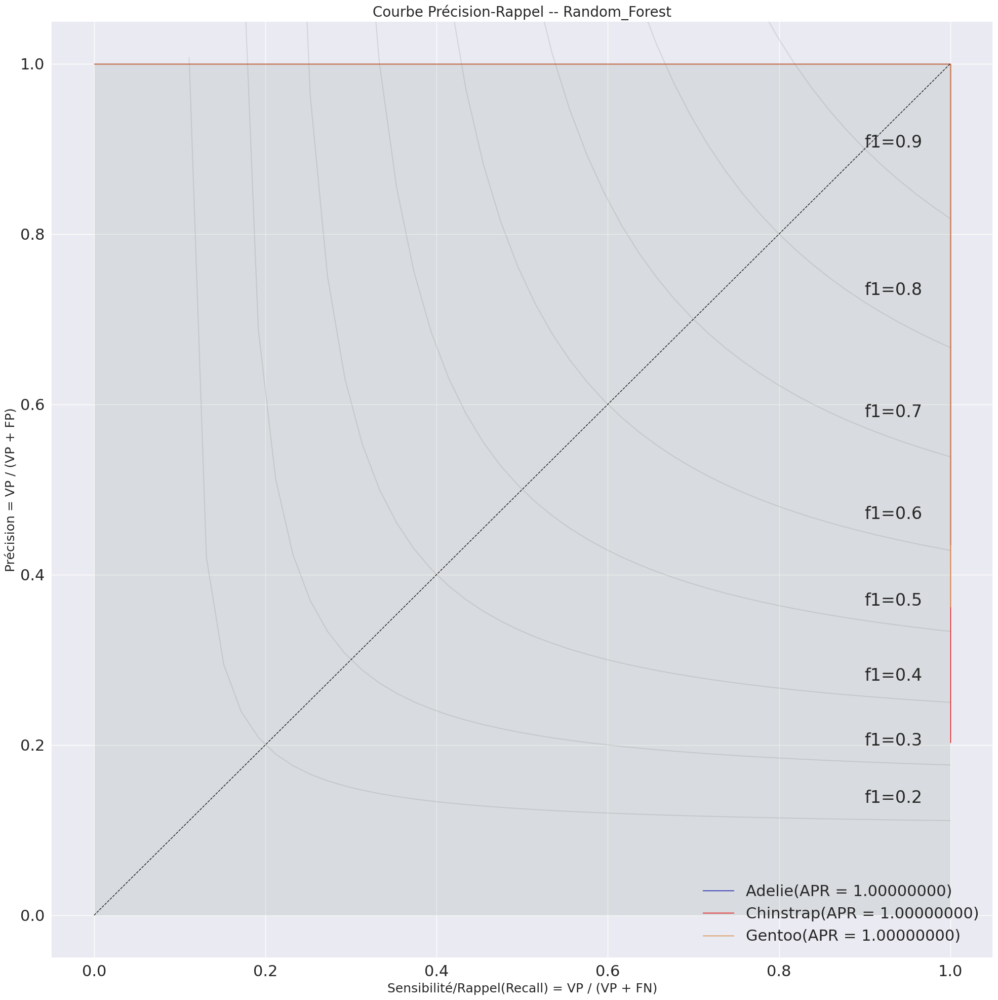

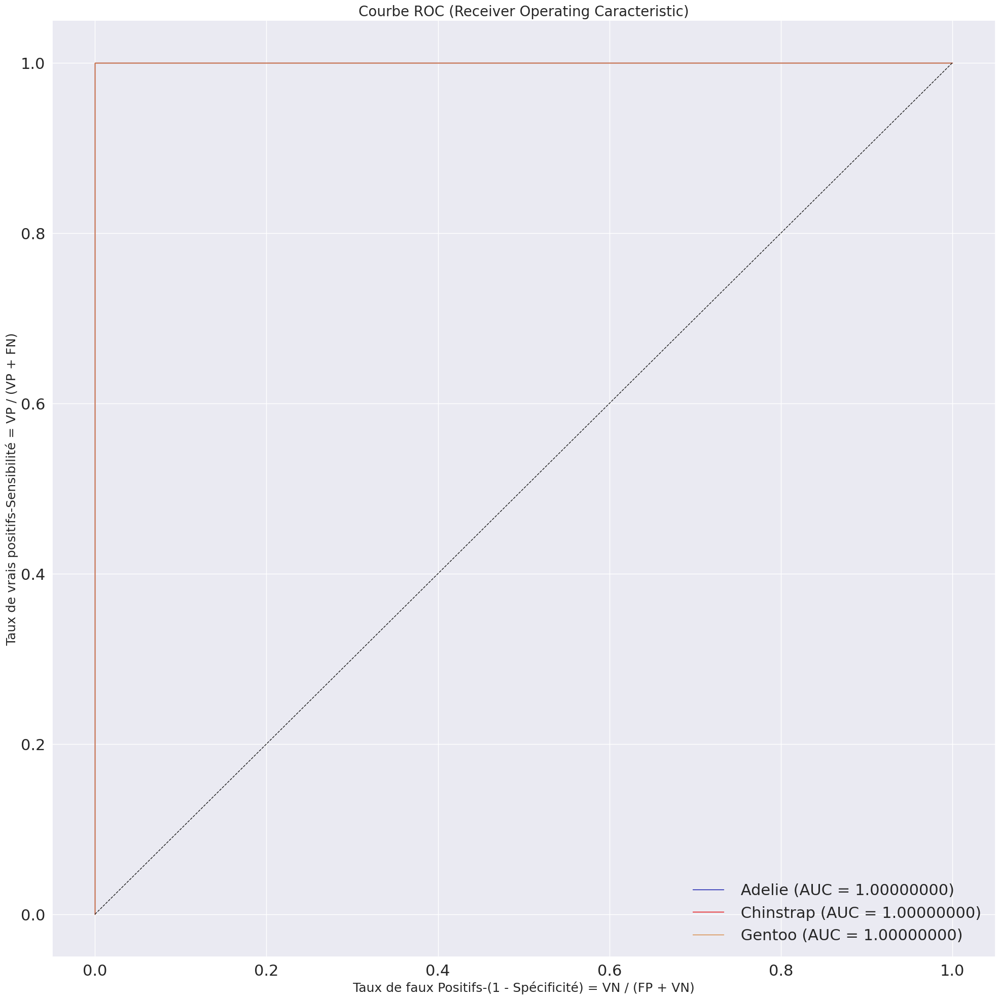

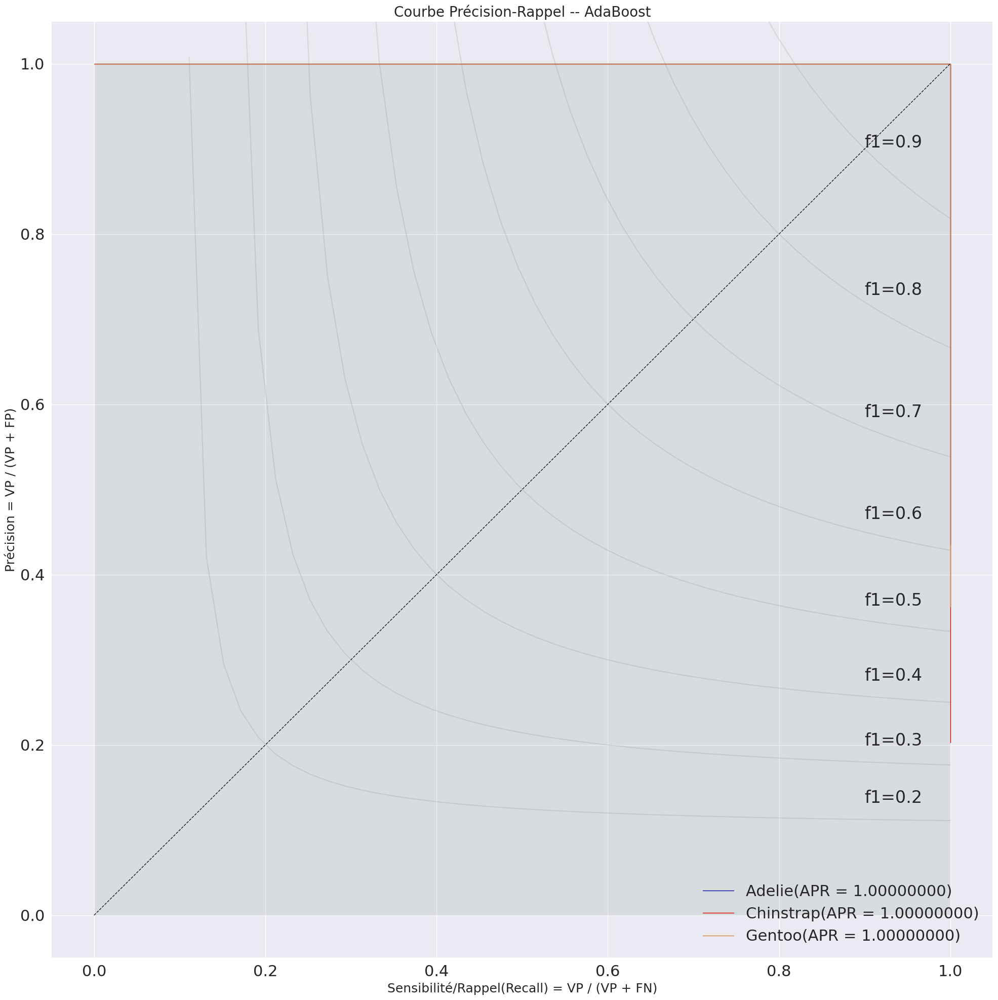

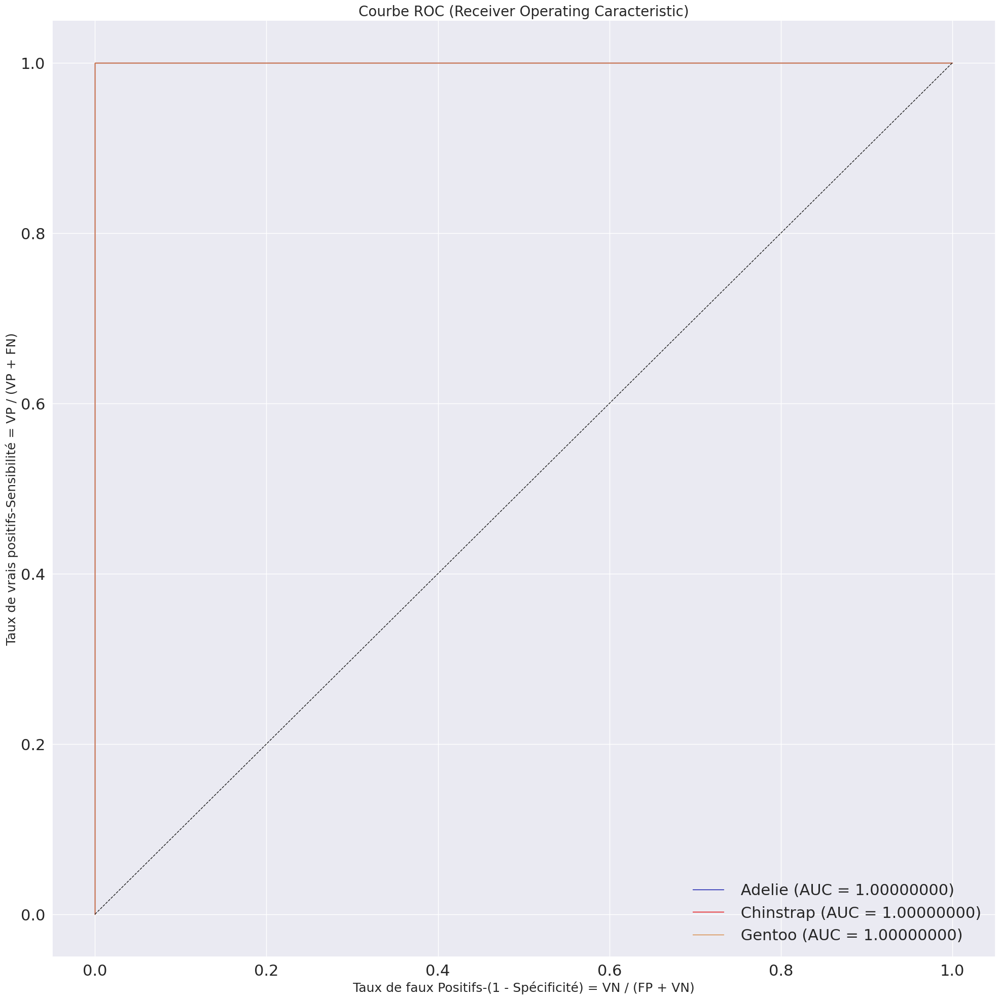

...

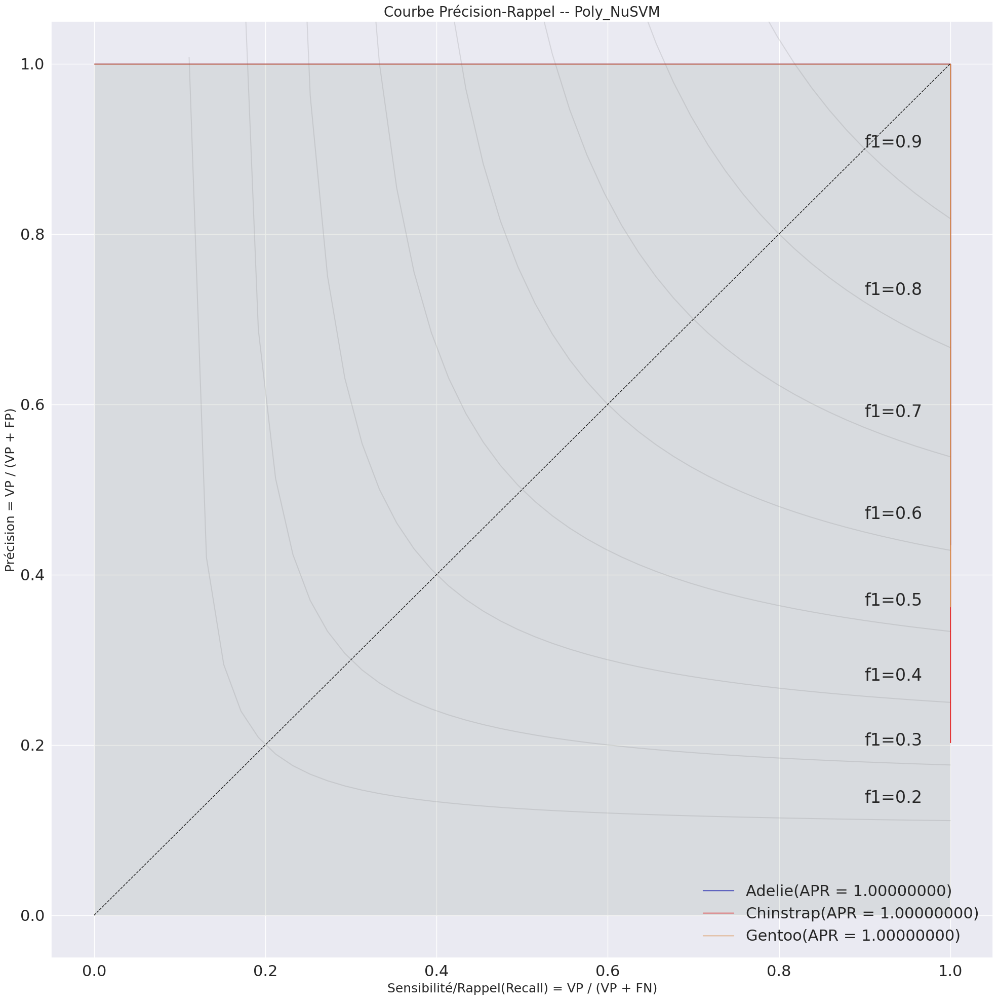

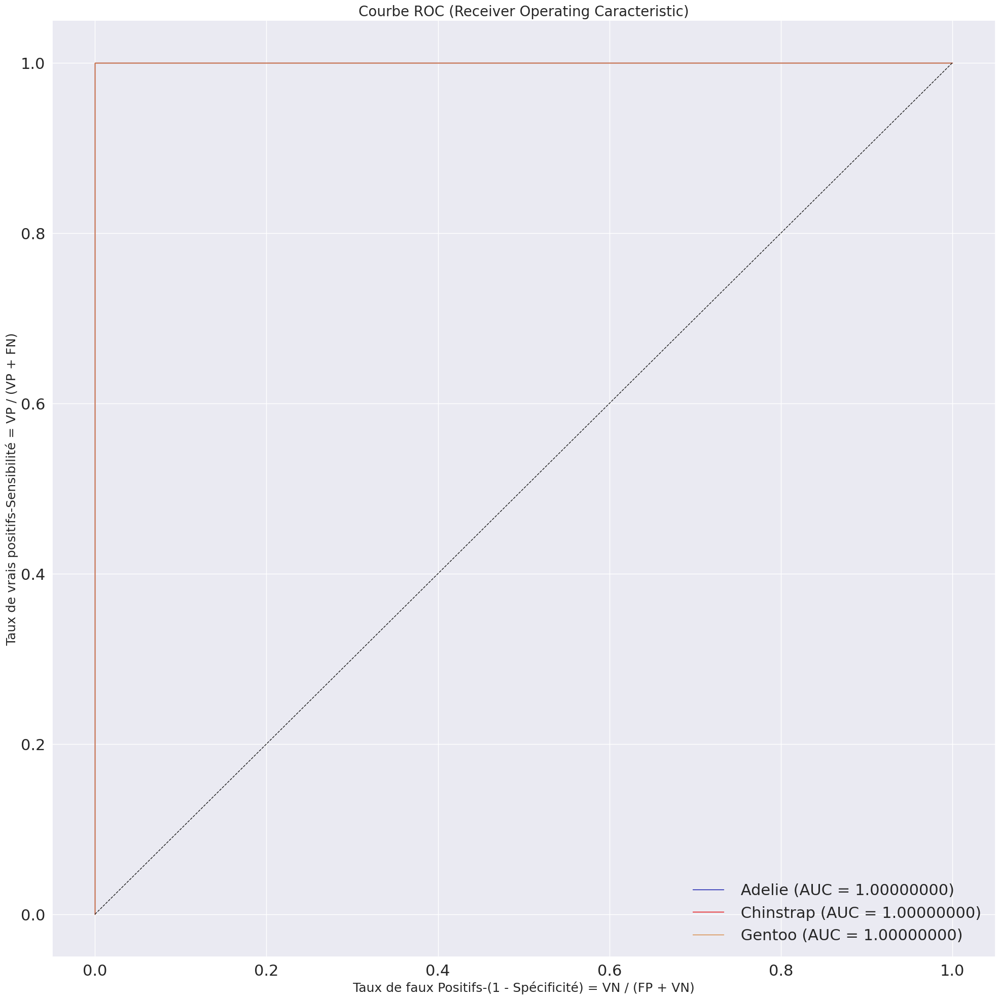

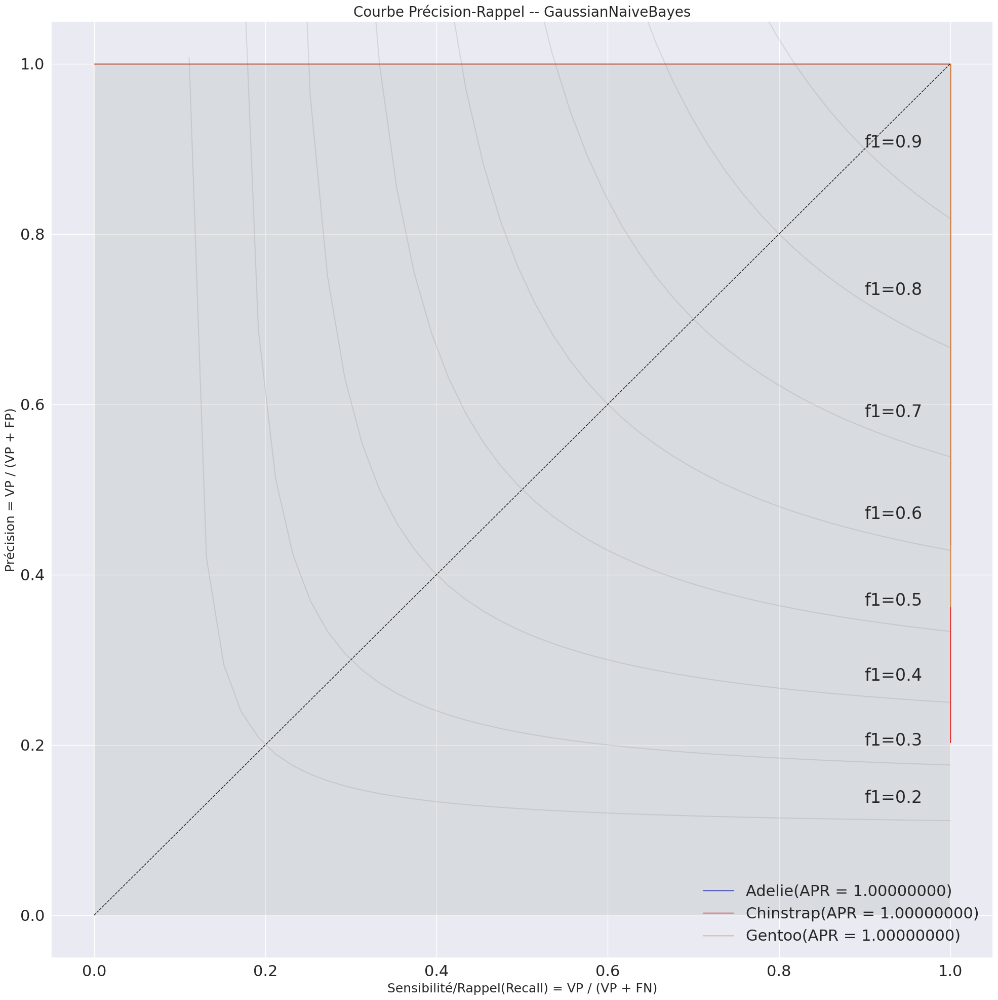

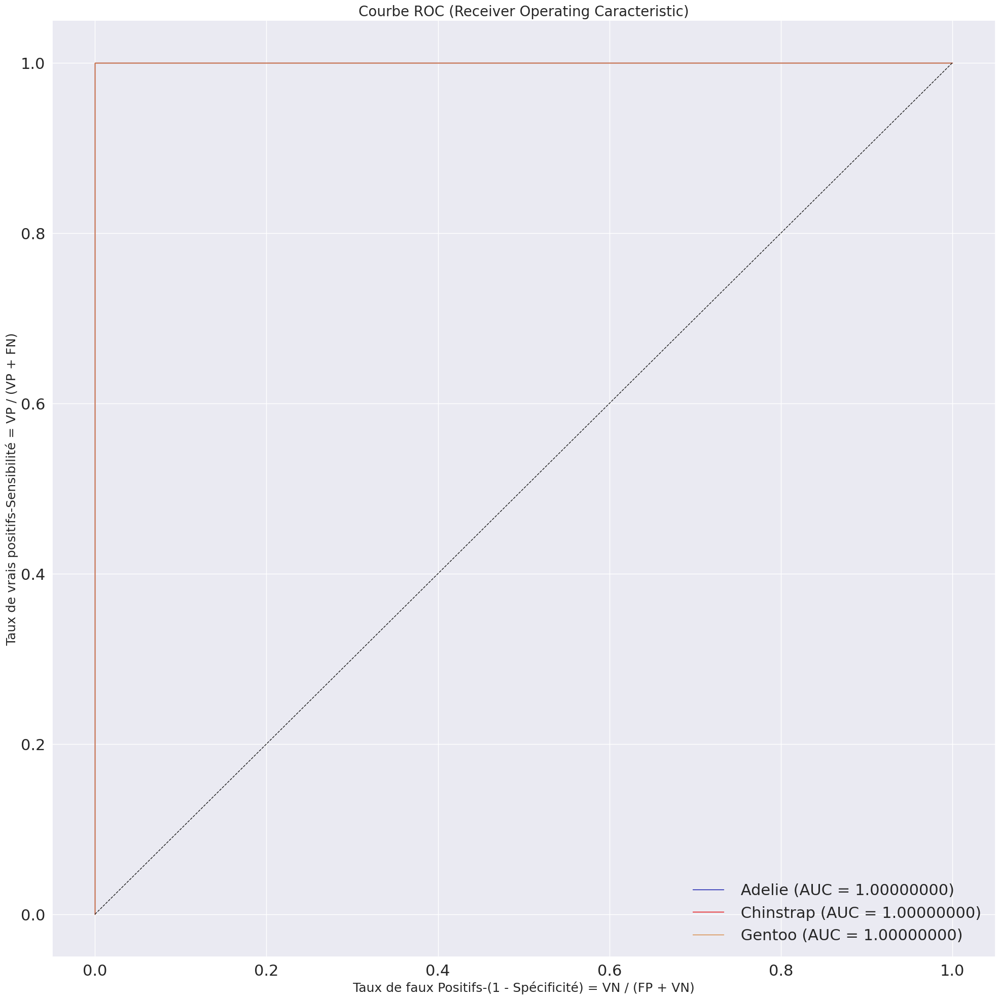

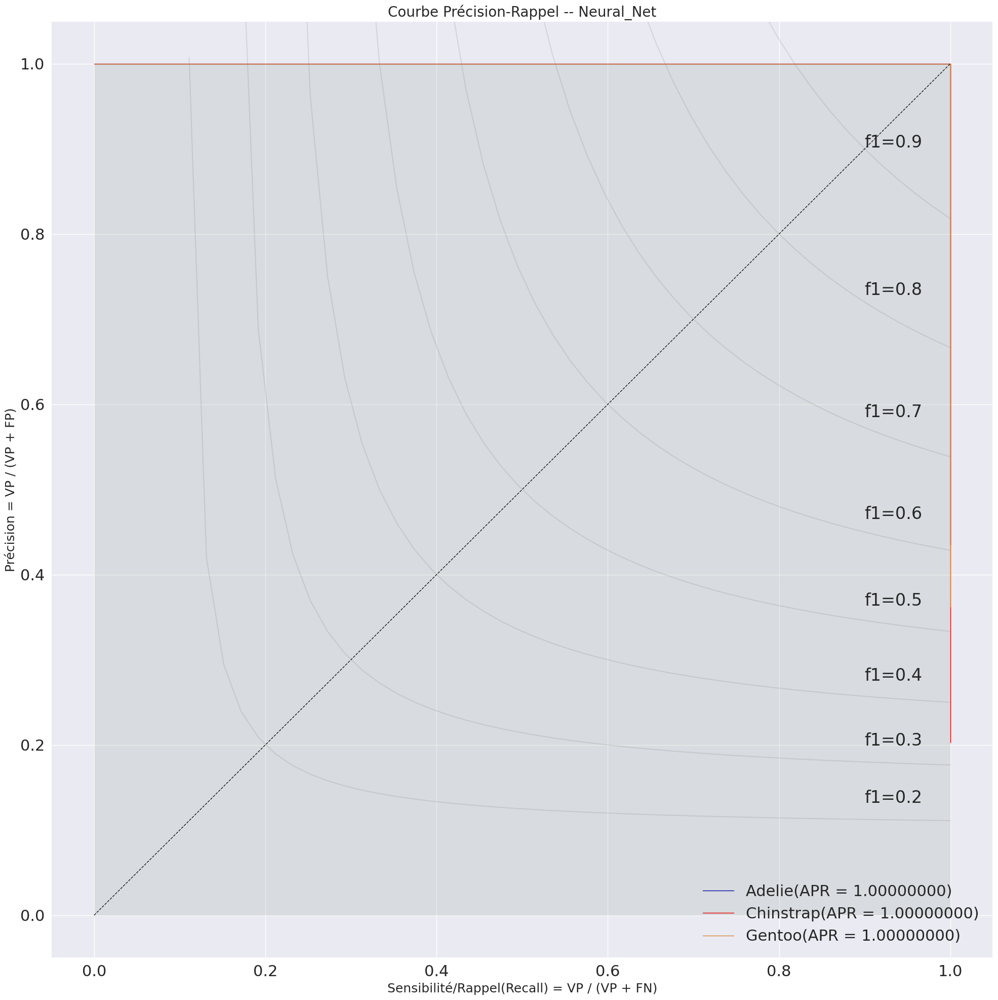

In [94]:
resultatsSS = executeApprentissageChoixClassifieurs(classifieursDict,X_train,y_train,X_test,y_test,dictR_species,
                                                    couleurs=couleursEspece.values(),nom_essai = 'StandardScaler')

In [95]:
resultats = pd.concat([resultats,resultatsSS])
resultats.loc[resultats.Classe == 'global',
              ['essai','Classifieur', 'Classe', 'aucROC', 
               'avgPrecRec', 'f1', 'f2', 'f05',
               'accuracy', 'precision', 'sensibilite']].sort_values('f1',ascending=False)

,essai,Classifieur,Classe,aucROC,avgPrecRec,f1,f2,f05,accuracy,precision,sensibilite
0,initial,Random_Forest,global,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
20,initial,Linear_SVM,global,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
28,StandardScaler,Poly_NuSVM,global,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
24,StandardScaler,Radial_NuSVM,global,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
12,StandardScaler,Gaussian_Process,global,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
0,StandardScaler,Random_Forest,global,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
8,initial,LogisticRegression,global,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
36,StandardScaler,Neural_Net,global,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
16,StandardScaler,Nearest_Neighbors,global,1.000000,0.999793,0.985634,0.985470,0.986055,0.985507,0.986473,0.985507
8,StandardScaler,LogisticRegression,global,1.000000,0.999793,0.985358,0.985358,0.985633,0.985507,0.985975,0.985507


# <b><div style='padding:15px;background-color:#d8dcd6;color:#030aa7;font-size:120%;text-align: left'>Uniquement variables quantitatives</div></b>

In [96]:
X_train.drop(columns=['island','sex'],inplace=True)
X_test.drop(columns=['island','sex'],inplace=True)

Random_Forest         0.9855	--	Area under the ROC curve : 0.9993	--	Exécution  :.36s
AdaBoost              0.9855	--	Area under the ROC curve : 0.9993	--	Exécution  :.09s
LogisticRegression    0.9855	--	Area under the ROC curve : 1.0000	--	Exécution  :.47s
Gaussian_Process      0.9710	--	Area under the ROC curve : 0.9993	--	Exécution  :.62s
Nearest_Neighbors     0.9565	--	Area under the ROC curve : 0.9986	--	Exécution  :.16s
Linear_SVM            0.9565	--	Area under the ROC curve : 0.9986	--	Exécution  :.05s
Radial_NuSVM          0.9710	--	Area under the ROC curve : 0.9993	--	Exécution  :.06s
Poly_NuSVM            1.0000	--	Area under the ROC curve : 1.0000	--	Exécution  :.06s
GaussianNaiveBayes    0.9420	--	Area under the ROC curve : 0.9871	--	Exécution  :.16s
Neural_Net            0.9855	--	Area under the ROC curve : 1.0000	--	Exécution  :.39s


<Figure size 1800x1800 with 0 Axes>

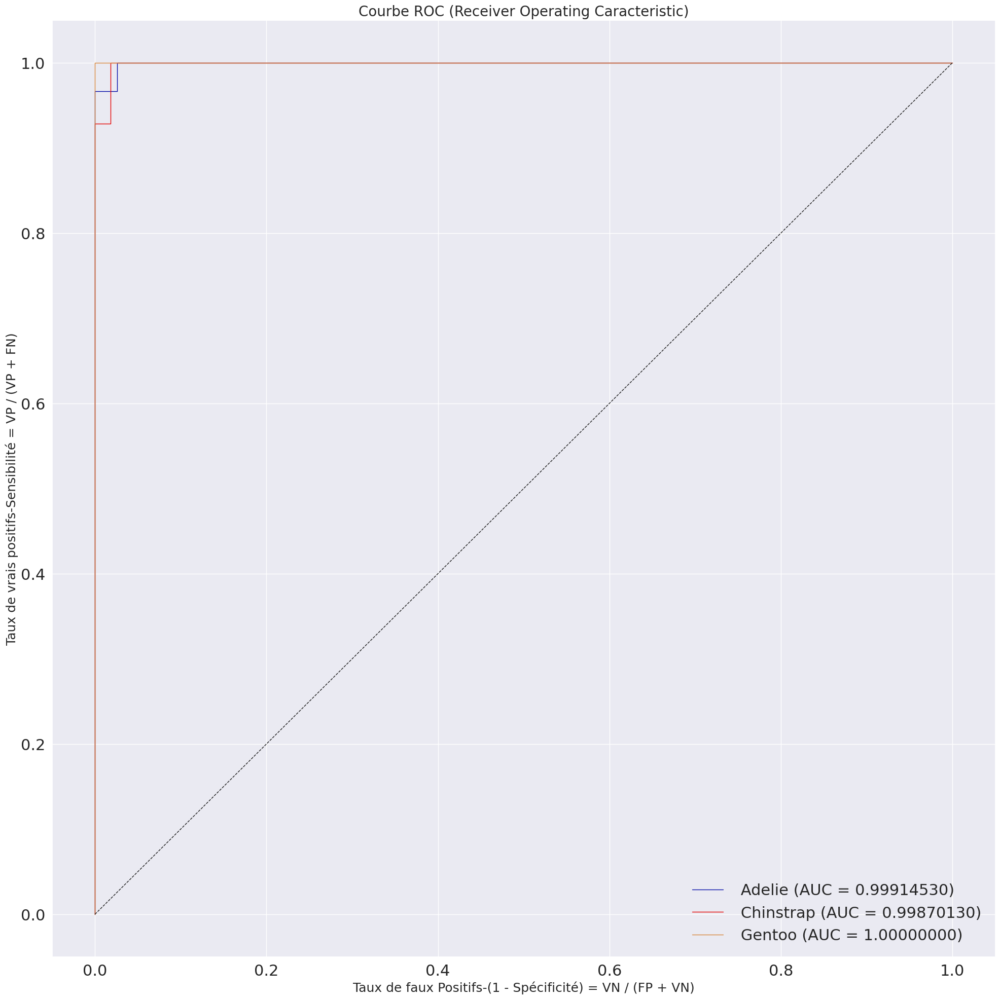

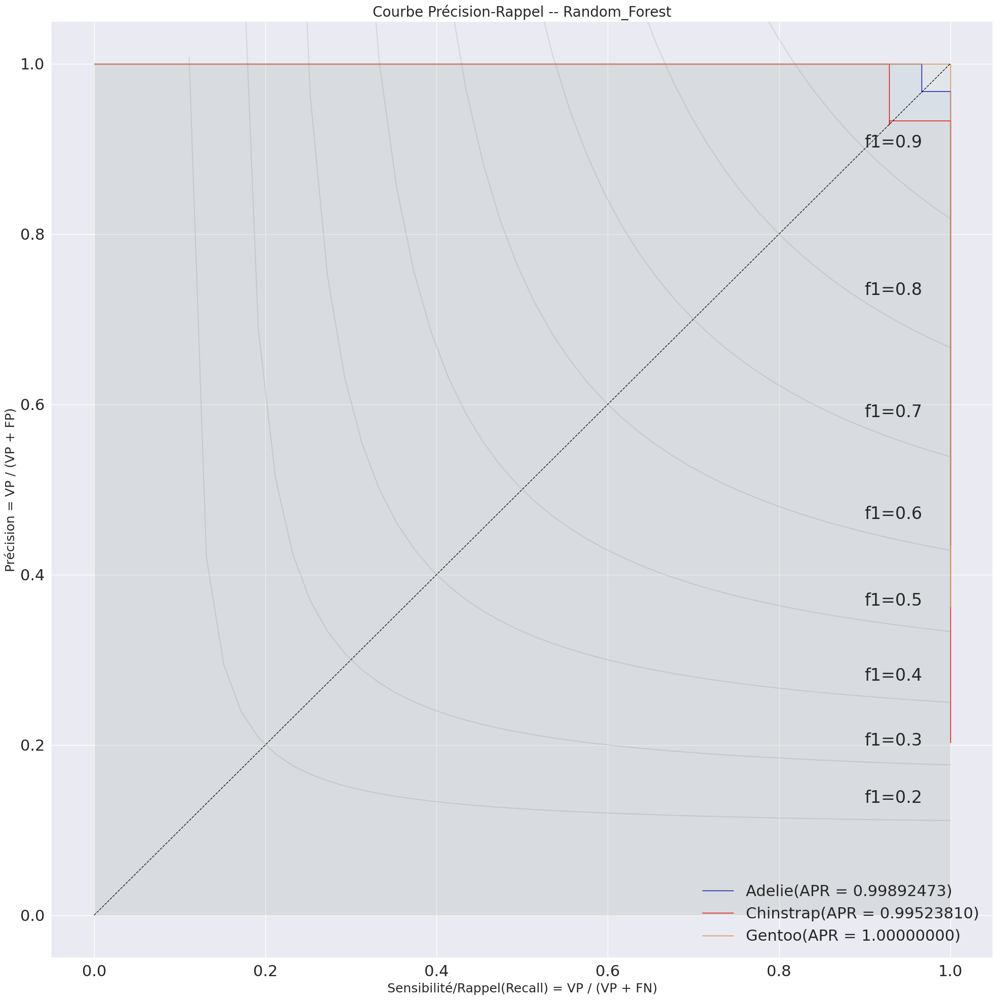

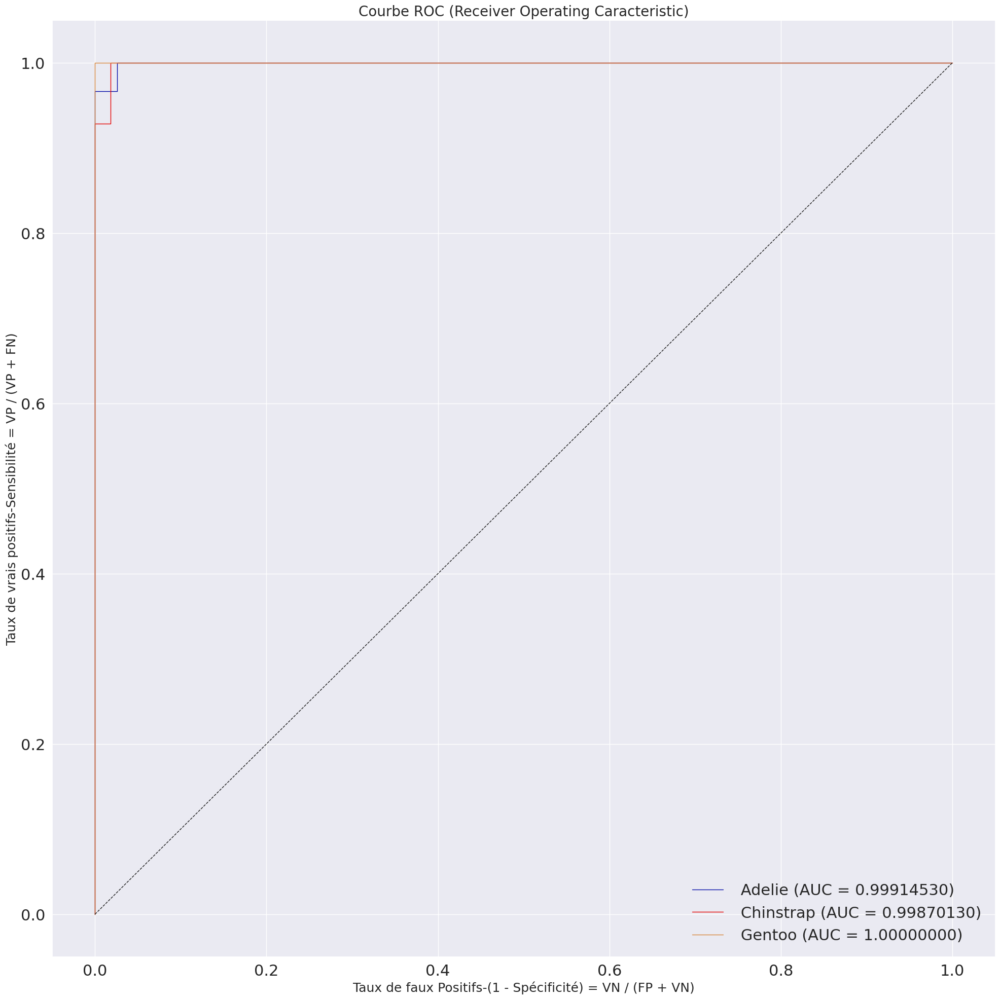

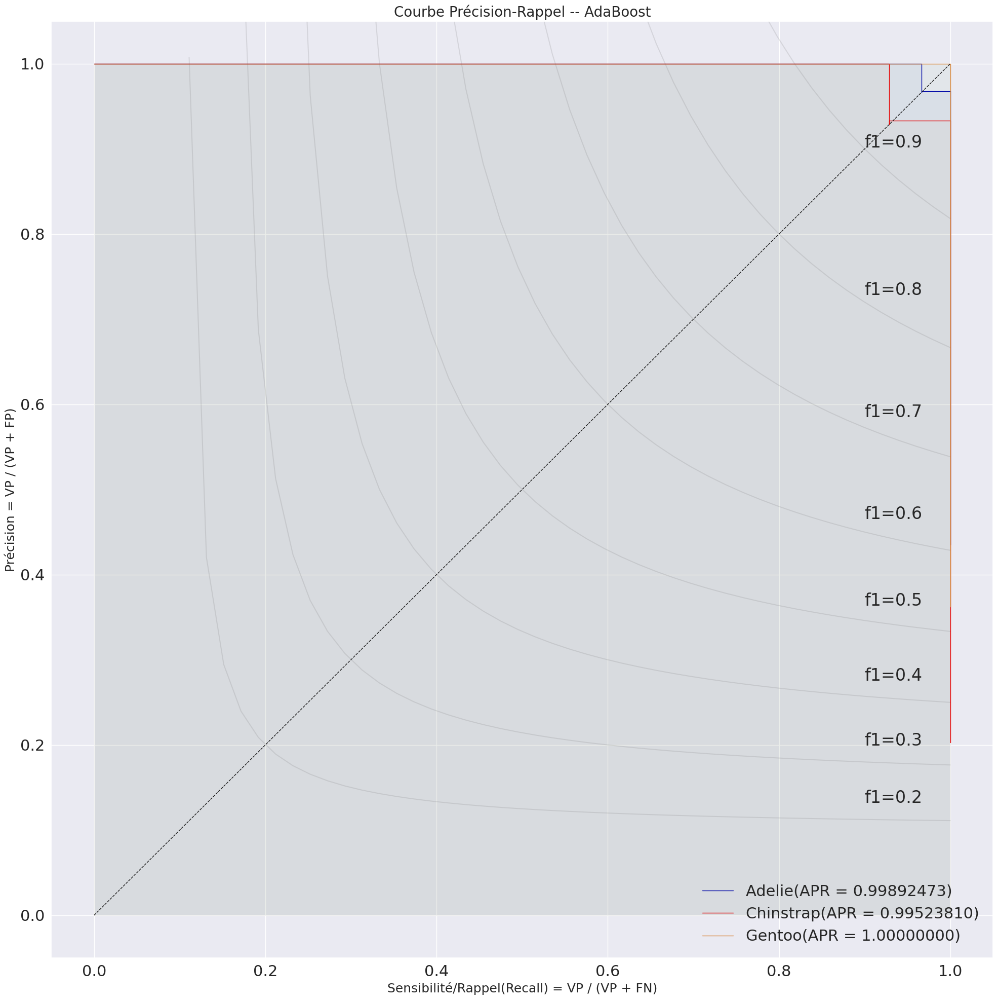

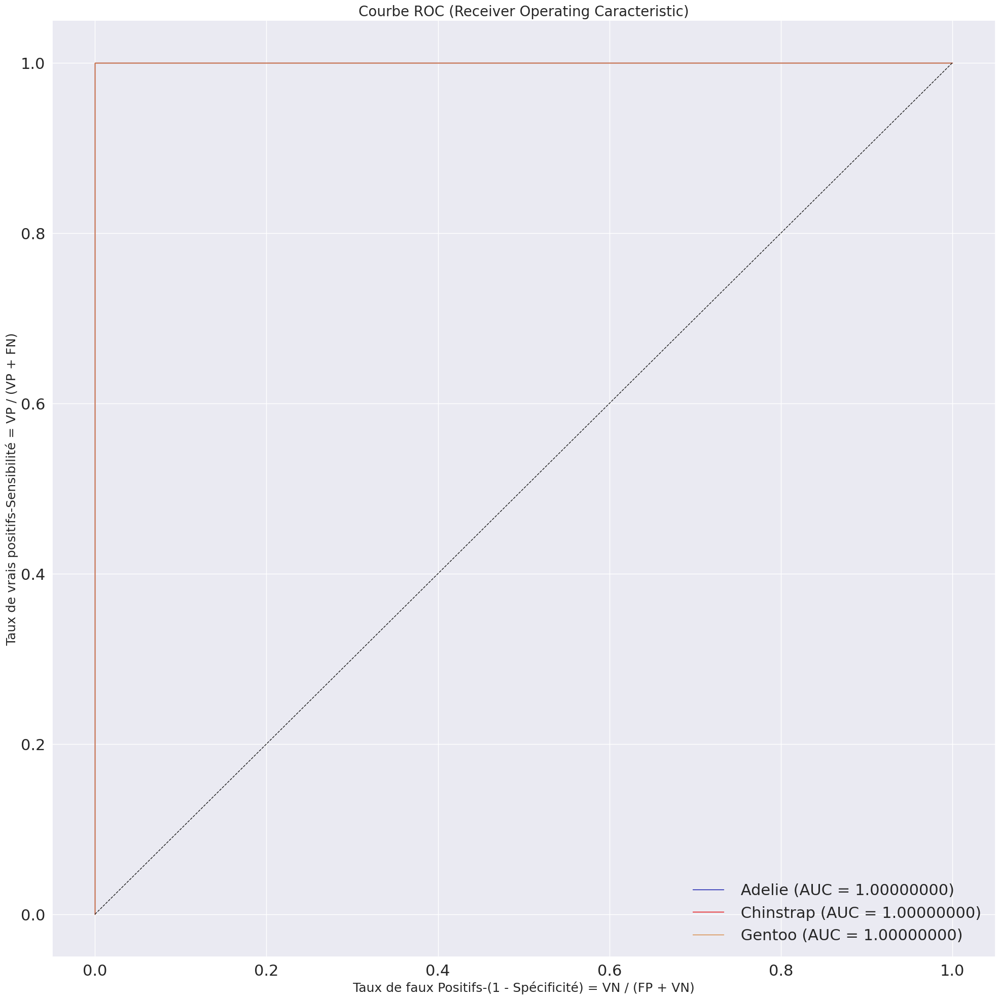

...

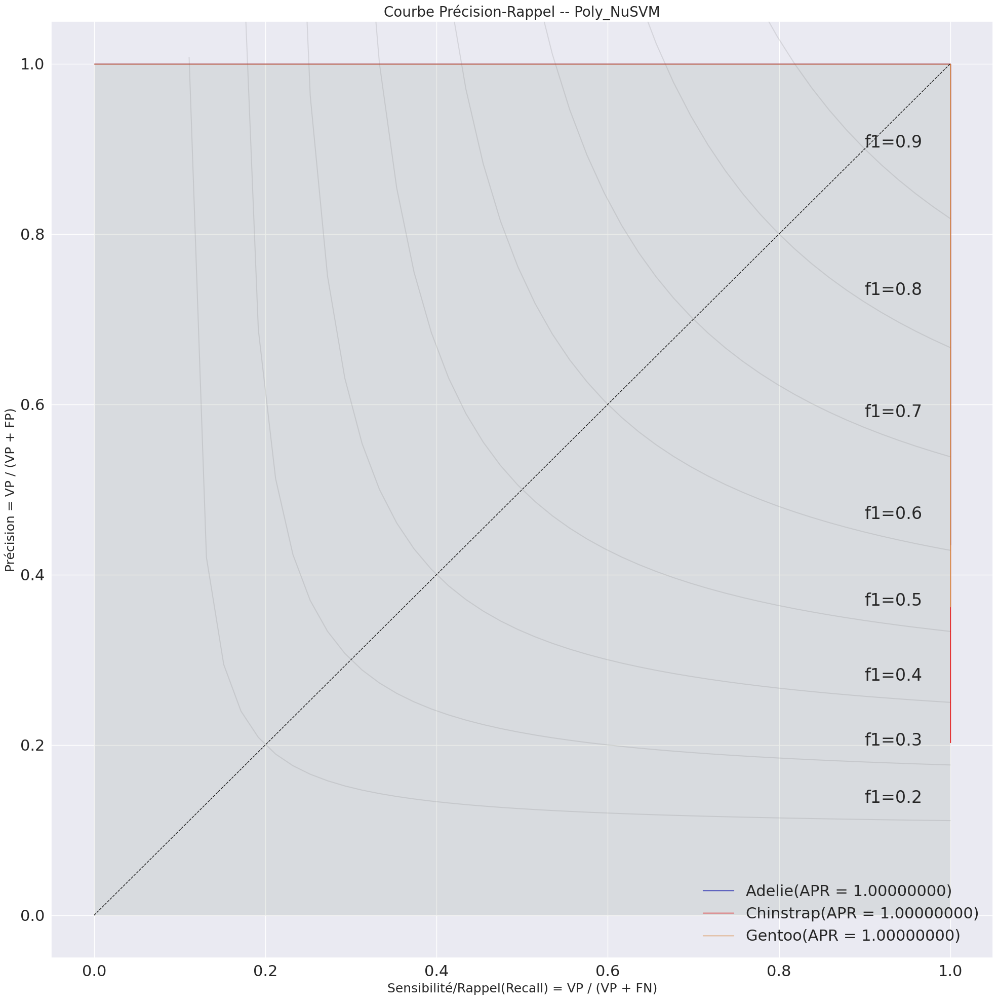

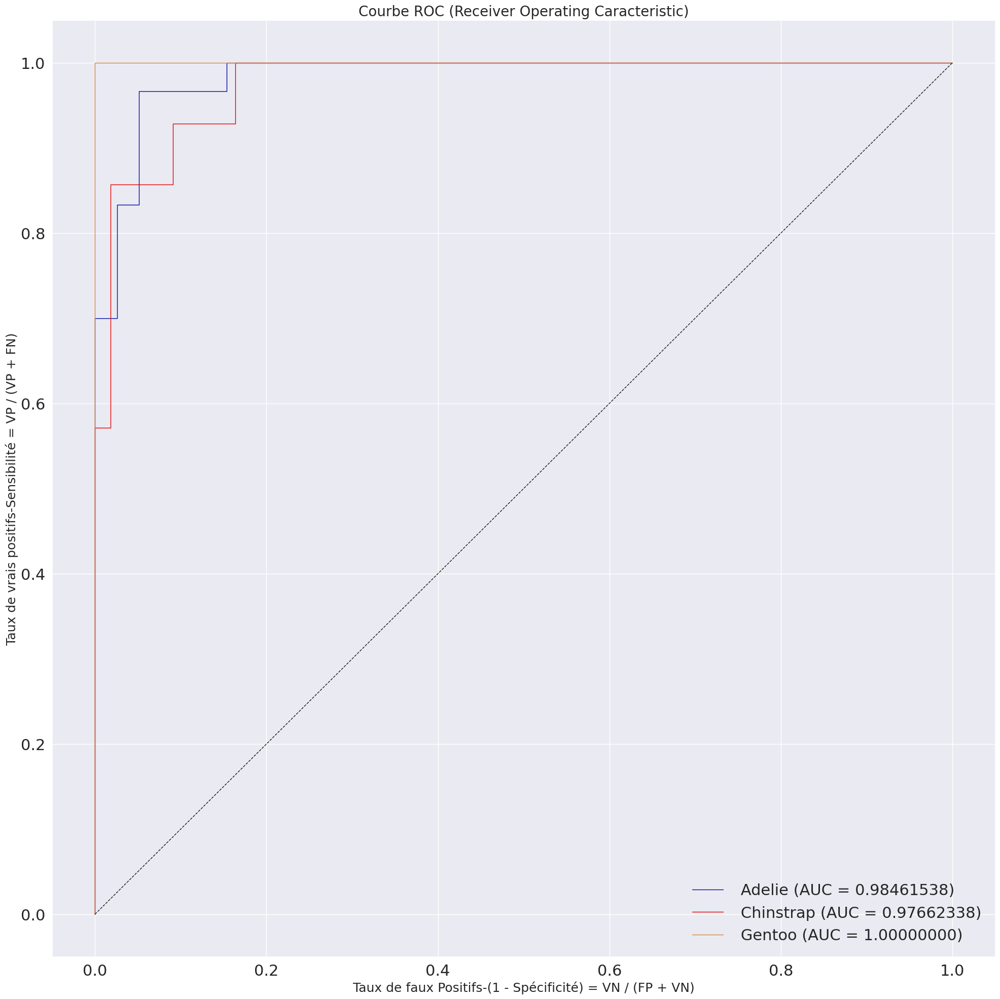

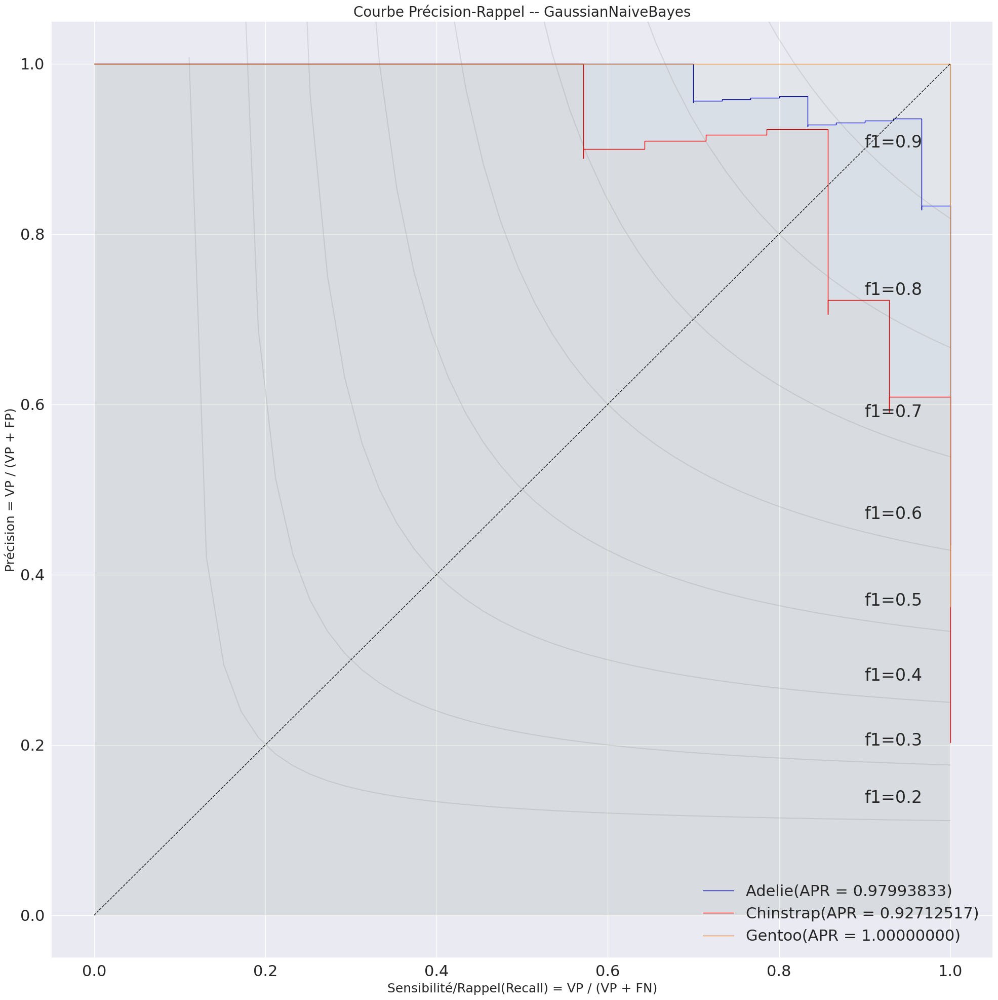

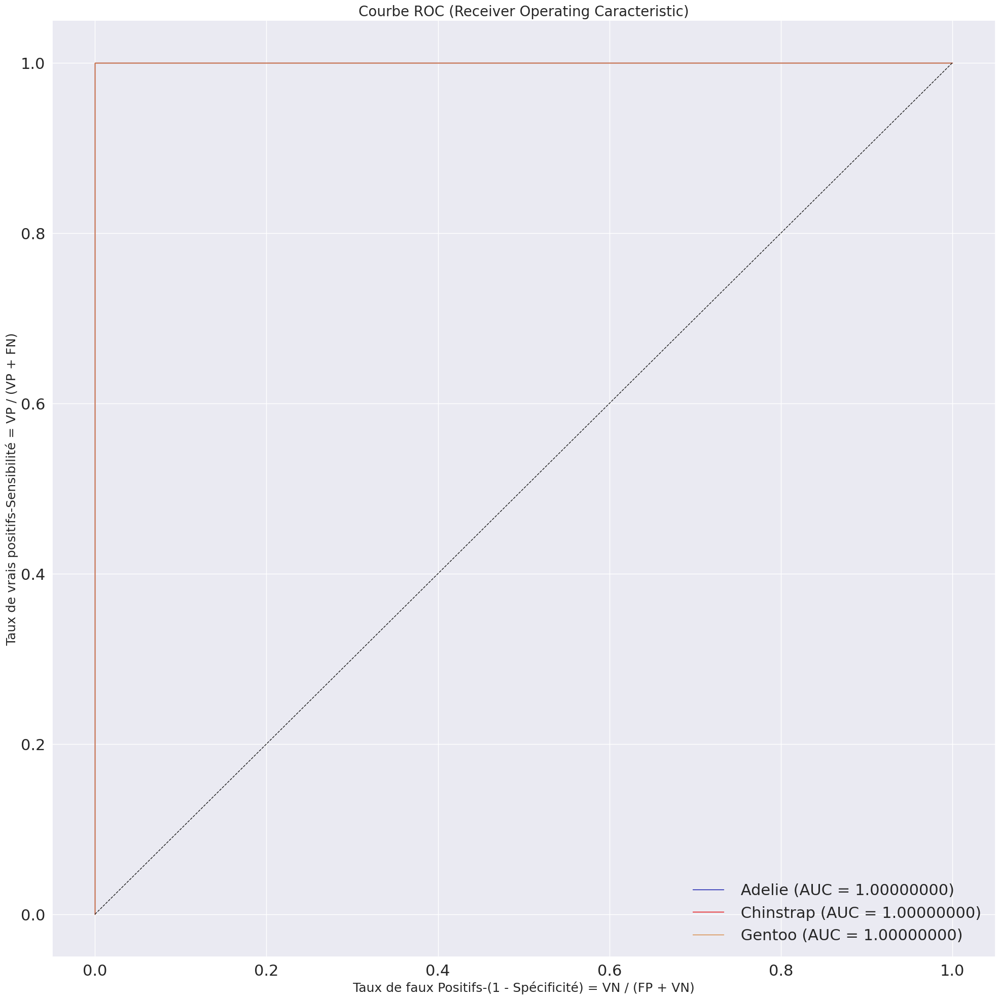

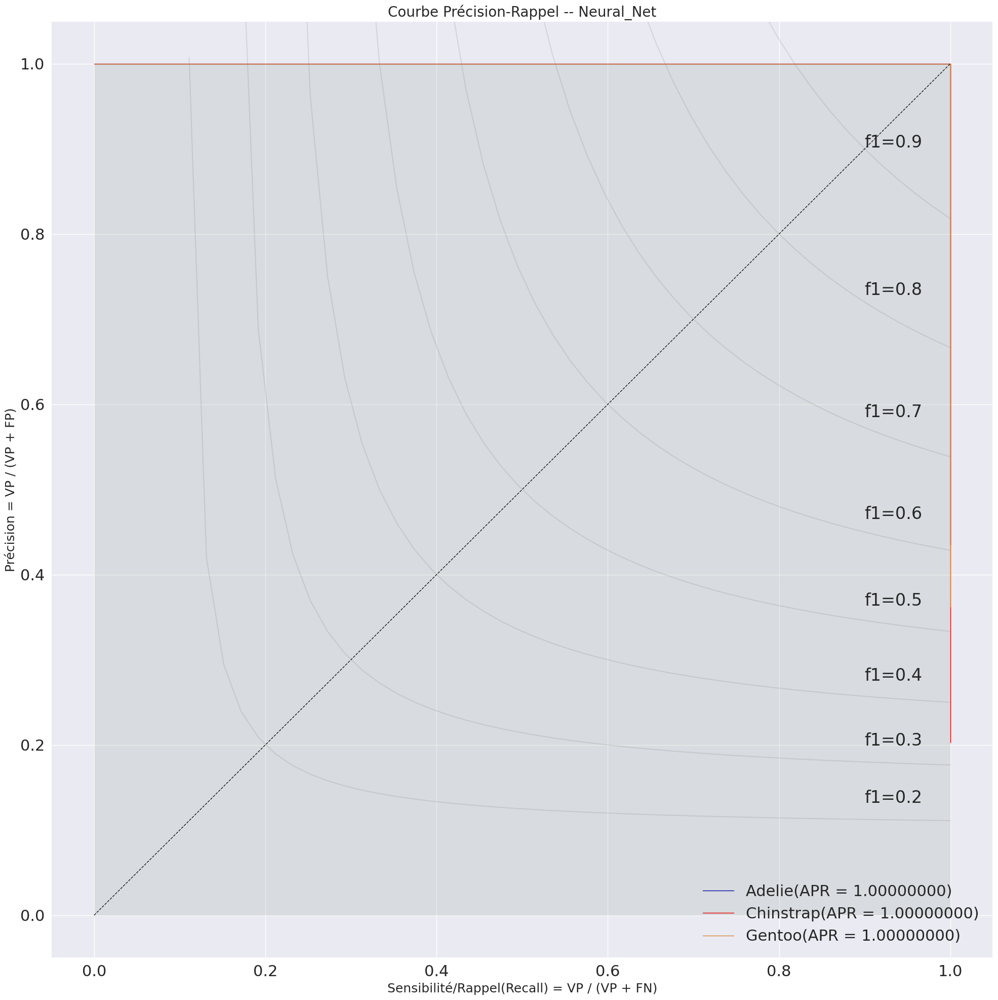

In [97]:
resultatsTemp = executeApprentissageChoixClassifieurs(classifieursDict,X_train,y_train,X_test,y_test,dictR_species,
                                                    couleurs=couleursEspece.values(),nom_essai = 'Quantitatives')

In [98]:
resultats = pd.concat([resultats,resultatsTemp])
resultats.loc[resultats.Classe == 'global',
              ['essai','Classifieur', 'Classe', 'aucROC', 
               'avgPrecRec', 'f1', 'f2', 'f05',
               'accuracy', 'precision', 'sensibilite']].sort_values('f1',ascending=False)

,essai,Classifieur,Classe,aucROC,avgPrecRec,f1,f2,f05,accuracy,precision,sensibilite
0,initial,Random_Forest,global,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
12,StandardScaler,Gaussian_Process,global,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
8,initial,LogisticRegression,global,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
28,Quantitatives,Poly_NuSVM,global,1.000000,0.998162,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
20,initial,Linear_SVM,global,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
36,StandardScaler,Neural_Net,global,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
28,StandardScaler,Poly_NuSVM,global,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
24,StandardScaler,Radial_NuSVM,global,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
0,StandardScaler,Random_Forest,global,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
4,Quantitatives,AdaBoost,global,0.999282,0.998566,0.985634,0.985470,0.986055,0.985507,0.986473,0.985507


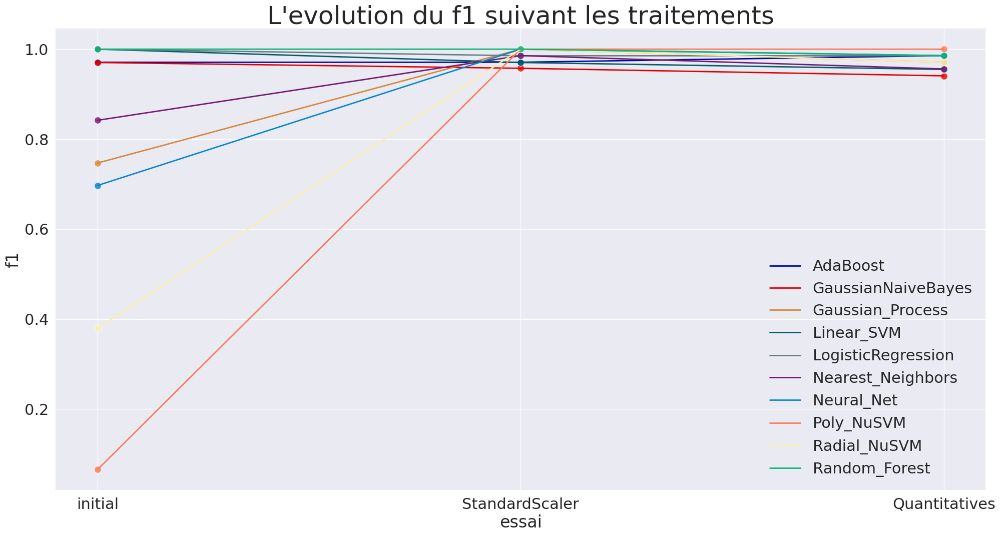

In [99]:
fig, ax = plt.subplots(figsize=(24,12))
for i, nom in enumerate(resultats['Classifieur'].sort_values().unique()):
    graph = sns.lineplot( x         = 'essai', 
                          y         = 'f1', 
                          data      = resultats[(resultats.Classe == 'global')&(resultats.Classifieur == nom)], 
                          estimator = None, 
                          lw        = 2, 
                          # ci        = None,
                          label     = nom,
                          color     = palette[i],
                          ax        = ax)
    sns.scatterplot( x     = 'essai', 
                     y     = 'f1', 
                     data  = resultats[(resultats.Classe == 'global')&(resultats.Classifieur == nom)], 
                     alpha = 0.8,   
                     s     = 100,
                     # ci    = None, 
                     color = palette[i],
                     ax    = ax,);
ax.set_title("L'evolution du f1 suivant les traitements",fontsize = 36);       